In [202]:
#Importamos librerias necesarias:
import pandas as pd
import re
from PyPDF2 import PdfReader
import fitz  # PyMuPDF
import re
import pandas as pd
import requests
from bs4 import BeautifulSoup
import os
from datetime import datetime

# Web scrapping

In [208]:
# Analizamos la pagina web de la que queremos extraer los datos:
url = "https://www.aragonempresa.com/empresas-sello-rsa/"
response = requests.get(url)
soup = BeautifulSoup(response.text, "lxml")

In [209]:
print(soup.prettify())

<!DOCTYPE html>
<html lang="es">
 <head>
  <script src="/js/script_previo.js?version=202304201600">
  </script>
  <meta charset="utf-8"/>
  <meta content="IE=edge" http-equiv="X-UA-Compatible"/>
  <meta content="width=device-width, initial-scale=1.0" name="viewport"/>
  <meta content="-1" http-equiv="expires"/>
  <meta content="Instituto Aragonés de Fomento" name="author"/>
  <meta content="Empresas con el sello de Responsabilidad Social de Aragón (RSA)" name="subject"/>
  <meta content="El Programa ARAGON EMPRESA del Instituto Aragonés de Fomento (IAF) tiene como objetivo actuar en la Mejora de la Competitividad de las empresas aragonesas, incidiendo en 8 áreas de gestión empresarial: Estrategia Empresarial, Personas, Marketing, Logística, 2.0, Ventas, Innovación y Finanzas. Departamento de Economía y Empleo, Gobierno de Aragón." name="Description"/>
  <meta content="Calidad" name="Classification"/>
  <meta content="" name="Keywords"/>
  <meta content="Zaragoza Aragón España" name="Ge

In [210]:
# Detectamos donde se alojan los datos que queremos extraer:
#<a href="imprimir.php?idusuario=987&amp;idencuesta=4" class="btn btn-default" target="_blank"><img src="../img/iconosanexos/icon_pdf.png" style="height:22px;">&nbsp;&nbsp;Cuestionario RSA - AUTONOMOS-AS</a>
# identificamos que se compone el documento pdf de cada entidad de la siguiente cadena:
# imprimir.php?idusuario=987&amp;idencuesta=4
# donde el numero 987 es el id de la empresa y el numero 4 es el id del cuestionario
# Por lo que podemos extraer los datos de cada empresa con el siguiente codigo:
for seccion in soup.find_all("a", href=True):
    if "imprimir.php" in seccion['href']:
        print(seccion['href'])

imprimir.php?idusuario=3125&idencuesta=4
imprimir.php?idusuario=1727&idencuesta=4
imprimir.php?idusuario=3541&idencuesta=4
imprimir.php?idusuario=1289&idencuesta=4
imprimir.php?idusuario=3192&idencuesta=4
imprimir.php?idusuario=1095&idencuesta=4
imprimir.php?idusuario=2759&idencuesta=4
imprimir.php?idusuario=696&idencuesta=4
imprimir.php?idusuario=2331&idencuesta=4
imprimir.php?idusuario=2119&idencuesta=4
imprimir.php?idusuario=536&idencuesta=4
imprimir.php?idusuario=2097&idencuesta=4
imprimir.php?idusuario=3234&idencuesta=4
imprimir.php?idusuario=1410&idencuesta=4
imprimir.php?idusuario=965&idencuesta=4
imprimir.php?idusuario=1754&idencuesta=4
imprimir.php?idusuario=1065&idencuesta=4
imprimir.php?idusuario=651&idencuesta=4
imprimir.php?idusuario=987&idencuesta=4
imprimir.php?idusuario=3446&idencuesta=4


In [206]:
# La pagina tiene un selector de paginas, por lo que podemos iterar sobre todas las paginas para extraer todos los datos:
# Tiene un estructura fija de 20 elementos por pagina, por lo que podemos iterar de 20 en 20 para extraer todos los datos
# Creamos una lista vacia para almacenar los datos de id de empresa y cuestionario para poder descargar los pdfs


lista_id = []

for i in range(0, 1580, 20):
    url = f"https://www.aragonempresa.com/empresas-sello-rsa/?start={i}&count=20"
    response = requests.get(url)
    soup = BeautifulSoup(response.text, "lxml")
    for seccion in soup.find_all("a", href=True):
        if "imprimir.php" in seccion['href']:
            match_usuario = re.search(r'idusuario=(\d+)&', seccion['href'])
            match_encuesta = re.search(r'idencuesta=(\d+)', seccion['href'])
            if match_usuario and match_encuesta:
                lista_id.append((match_usuario.group(1), match_encuesta.group(1)))


In [217]:
lista_id.sort()
lista_id

[('1000', '7'),
 ('1001', '6'),
 ('1002', '6'),
 ('1004', '9'),
 ('1005', '6'),
 ('1009', '6'),
 ('1010', '6'),
 ('1011', '6'),
 ('1013', '6'),
 ('1014', '6'),
 ('1015', '6'),
 ('102', '7'),
 ('1032', '9'),
 ('1036', '6'),
 ('1037', '4'),
 ('1047', '6'),
 ('1051', '6'),
 ('1054', '9'),
 ('1056', '9'),
 ('1057', '9'),
 ('1058', '7'),
 ('1059', '9'),
 ('1060', '9'),
 ('1061', '9'),
 ('1063', '9'),
 ('1064', '9'),
 ('1065', '4'),
 ('107', '7'),
 ('1073', '9'),
 ('1074', '6'),
 ('1075', '7'),
 ('1076', '6'),
 ('1078', '6'),
 ('1079', '6'),
 ('1080', '6'),
 ('1081', '6'),
 ('1082', '6'),
 ('1083', '6'),
 ('1084', '6'),
 ('1086', '9'),
 ('1090', '6'),
 ('1092', '6'),
 ('1093', '6'),
 ('1094', '7'),
 ('1095', '4'),
 ('1097', '6'),
 ('1099', '4'),
 ('110', '9'),
 ('1102', '6'),
 ('1110', '9'),
 ('1139', '6'),
 ('1140', '6'),
 ('1141', '6'),
 ('1144', '6'),
 ('1145', '6'),
 ('1146', '6'),
 ('1147', '6'),
 ('1150', '6'),
 ('1151', '7'),
 ('1152', '6'),
 ('1154', '6'),
 ('1156', '7'),
 ('1159', '

In [218]:
# Directorio donde quieres guardar los PDFs
carpeta_destino = r"C:\Users\josel\Thebridge\REPO_ZERO\ML_enviroment_rsa_2025\data_ignore\EDA"

# Asegúrate de que la carpeta de destino existe
os.makedirs(carpeta_destino, exist_ok=True)

for i, j in lista_id:
    # Construir la ruta completa del archivo
    ruta_archivo = os.path.join(carpeta_destino, f"empresa_sello_rsa_{i}_{j}.pdf")

    # Verificar si el archivo ya existe
    if not os.path.exists(ruta_archivo):
        pdf_url = f"https://www.aragonempresa.com/empresas-sello-rsa/imprimir.php?idusuario={i}&idencuesta={j}"
        response = requests.get(pdf_url)
        with open(ruta_archivo, "wb") as file:
            file.write(response.content)
        print(f"Descargado y guardado {ruta_archivo}")
    else:
        print(f"El archivo {ruta_archivo} ya existe, omitiendo descarga.")

El archivo C:\Users\josel\Thebridge\REPO_ZERO\ML_enviroment_rsa_2025\data_ignore\EDA\empresa_sello_rsa_1000_7.pdf ya existe, omitiendo descarga.
El archivo C:\Users\josel\Thebridge\REPO_ZERO\ML_enviroment_rsa_2025\data_ignore\EDA\empresa_sello_rsa_1001_6.pdf ya existe, omitiendo descarga.
El archivo C:\Users\josel\Thebridge\REPO_ZERO\ML_enviroment_rsa_2025\data_ignore\EDA\empresa_sello_rsa_1002_6.pdf ya existe, omitiendo descarga.
El archivo C:\Users\josel\Thebridge\REPO_ZERO\ML_enviroment_rsa_2025\data_ignore\EDA\empresa_sello_rsa_1004_9.pdf ya existe, omitiendo descarga.
El archivo C:\Users\josel\Thebridge\REPO_ZERO\ML_enviroment_rsa_2025\data_ignore\EDA\empresa_sello_rsa_1005_6.pdf ya existe, omitiendo descarga.
El archivo C:\Users\josel\Thebridge\REPO_ZERO\ML_enviroment_rsa_2025\data_ignore\EDA\empresa_sello_rsa_1009_6.pdf ya existe, omitiendo descarga.
El archivo C:\Users\josel\Thebridge\REPO_ZERO\ML_enviroment_rsa_2025\data_ignore\EDA\empresa_sello_rsa_1010_6.pdf ya existe, omiti

In [ ]:
# Analizando los formularios pdf descargados hemos detectado que hay 4 tipos de formularios pero hemos detectado las siguientes variables relevantes y que son comunes a los 4:

| Variable                  | Tipo   |Descripción|
|---------------------------|--------|-|
| tipo_organizacion         | object |Autonomo (120), Pequeña empresa (850), Mediana empresa (124), Gran empresa (113), Empresa publica (18), Entidades(301), Ong(47), ojo el formulario es el mismo en contenido pero se han detectado diferencias, necesario ajustes |
| nombre_organizacion       | object |Anonimizaremos por Tipo+numero|
| direccion                 | object |Nos servira para geolocalizar en mapa|
| sector_actividad          | object |Analizar, variable importante para agrupar, esta en lenguaje natural, habra que standarizarla de alguna forma|
| ano_comienzo_actividad    | object |Convertir a temporal, consideramos puede ser relevante|
| persona_contacto          | object |Anonimizar, se usara en la fase de contacto|
| email_contacto            | object |Anonimizar, seria interesante analizar codigo necesario para envio masivo email contacto|
| pagina_web                | object |Solo util para profundizar departamento comercial para adecuar oferta de servicios y conocer al cliente.|
| impacto_actividad         | object |Es lenguaje natural y recoge la valoración que da el cliente al impacto de su actividad en el medioambiente, puede ser interesante o no|
| prioridad mediambiental   | object |En un primer momento valoro solo indicar de 1 a 10 la importancia que le da a medioambiente, pero barajo la opcion de extender y recoger la escala de priorizacion de las 10 propuesta, ya que podria aportar matices del perfil de la entidad
|||Emplear prácticas empresariales abiertas y transparentes
|||Gestionar con ejemplaridad
|||Escuchar las necesidades y expectativas de sus grupos de interés
|||Poner en práctica medidas responsables en la gestión de Recursos Humanos
|||Ofrecer productos y servicios de calidad
|||Capacitación y desarrollo profesional
|||Disponer de presupuesto
|||Trabajar para proteger y mejorar el medio ambiente
|||Crear Programas con impacto positivo en la Comunicad Local
|||Ser un negocio rentable y sostenible en el tiempo|
| mejora                    | object |Es lenguaje natural y creo seria interesante detectar palabras claves que releven necesidades a cubrir en medioambiente o en otras areas que detecten nichos de mercado futuros para la entidad|

In [328]:
import re
import fitz  # PyMuPDF

def extraer_datos(pdf_path):
    datos = {}

    with fitz.open(pdf_path) as pdf:
        texto_completo = ""

        # Concatenar todo el texto de las páginas del PDF
        for page_num in range(len(pdf)):
            texto_completo += pdf[page_num].get_text()

        # Patrón para eliminar faldones de página (ej. "[...] página X/XX")
        patron_faldon = r'''\[-\d+\]# Número negativo entre corchetes
        \s*RSA\s-\s     # Literal "RSA -", seguido de espacios
        (Entidades\sno\slucrativas|GRANDES\sEMPRESAS\sY\sEMPRESAS\sPÚBLICAS|AUTONOMOS-AS|PYMES)?  # Opciones
        \s*página\s\d+/\d+\n?  # "página X/XX", opcionalmente con salto de línea final
        '''

        # Eliminar faldones del texto completo
        texto_sin_faldon = re.sub(patron_faldon, '', texto_completo, flags=re.VERBOSE | re.DOTALL)


        # ID del cliente y formulario
        datos["id_cliente"] = pdf_path.split("_")[-2]
        datos["id_formulario"] = pdf_path.split("_")[-1]

        # Tipo de organización
        patron_tipo = r"\n*RSA - (.*?)\n*Empresa evaluada"
        match_tipo = re.search(patron_tipo, texto_sin_faldon, re.DOTALL)
        if match_tipo:
            datos['tipo_organizacion'] = match_tipo.group(1).replace("\n", " ").strip()

        # Denominación de la organización
        patron_nombre = r"(\d{2} - )?Denominación de la organización\n(.*?)\n(02 - Dirección - CP - Población)?(Forma jurídica)?"
        match_nombre = re.search(patron_nombre, texto_sin_faldon, re.DOTALL | re.IGNORECASE)
        if match_nombre:
            datos['nombre_organizacion'] = match_nombre.group(2).replace("\n", " ").strip()

        # Dirección
        patron_direccion = r"(\d{2} - )?Dirección - CP - Poblaci[oó]n\n(.*?)(\d{2} - )?Sector(. Actividad)?(/Ámbito de actuación.)?"
        match_direccion = re.search(patron_direccion, texto_sin_faldon, re.DOTALL | re.IGNORECASE)
        if match_direccion:
            datos['direccion'] = match_direccion.group(2).replace("\n", " ").strip()

        # Sector y actividad principal
        
        patron_sector = r'\b(?:Sector(?:\. Actividad)?(?:/Ámbito de actuación\.)?|03 - Sector\. Actividad)\s*\n(.*?)(?=\n(?:Actividad principal|04 - Año comienzo actividad))'



        match_sector = re.search(patron_sector, texto_sin_faldon, re.DOTALL)
        if match_sector:
            datos['sector_actividad'] = match_sector.group(1).replace("\n", " ").strip()

        # # Año de comienzo de actividad
        
        
        patron_year = r'(04 - )?Año comienzo actividad\.\n(.*?)\n(05 - Persona de contacto)?(05 - Número de personas empleadas)?(Número de personas empleadas - media anual)?'
        match_year = re.search(patron_year, texto_sin_faldon, re.DOTALL | re.IGNORECASE)
        if match_year:
            datos['year'] = match_year.group(2).strip()  # Captura el año (2016)
        

        # # Número de personas empleadas
        
        patron_empleados = (
            r'(05 - )?Número de personas empleadas( - media anual)?\n'  # Inicio del bloque
            r'(.*?)(?=(06 - Persona contacto|Número de personas empleadas estables \(contrato indefinido\)|$))'  # Capturar todo hasta antes del siguiente bloque o el final
            )


        # Buscar coincidencia
        match_empleados = re.search(patron_empleados, texto_sin_faldon, re.DOTALL | re.IGNORECASE)
        if match_empleados:
            datos["empleados"] = match_empleados.group(3).strip()  # Captura todo el bloque intermedio


        # Persona de contacto
        patron_persona_contacto = r'\n(\d{2} - )?Persona (de )?contacto\n(.*?)\n(\d{2})?(E-mail contacto)?'
        match_persona_contacto = re.search(patron_persona_contacto, texto_sin_faldon, re.DOTALL | re.IGNORECASE)
        if match_persona_contacto:
            datos['persona_contacto'] = match_persona_contacto.group(3).replace("\n", " ").strip()

        # E-mail de contacto
        patron_email_contacto = r'\n(\d{2} - )?e-mail (persona )?contacto:?\n(.*?)\n(\d{2}.- )?Página web'
        match_email_contacto = re.search(patron_email_contacto, texto_sin_faldon, re.DOTALL | re.IGNORECASE)
        if match_email_contacto:
            datos['email_contacto'] = match_email_contacto.group(3).replace("\n", " ").strip()

        # Página web
        patron_pagina_web = r'\n(\d{2}.- )?Página web\n(.*?)\n*GENERAL'
        match_pagina_web = re.search(patron_pagina_web, texto_sin_faldon, re.DOTALL)
        if match_pagina_web:
            datos['pagina_web'] = match_pagina_web.group(2).replace("\n", " ").strip()

        # Impacto ambiental

        patron_impacto_actividad = r'(impacto )?ambiental en el desarrollo de la actividad\?\s*([\s\S]*?)\s*(?=Economía circular( y comunicación)?)'

        # Búsqueda en el texto
        match_impacto_actividad = re.search(patron_impacto_actividad, texto_sin_faldon, re.DOTALL)

        if match_impacto_actividad:
            datos["impacto_actividad"] = match_impacto_actividad.group(2).replace("\n", " ").strip()
    
        # Prioridad medioambiental
        patron_prioridad_medioambiental = r"(\d+) - Trabajar para proteger y mejorar el medio ambiente"
        match_prioridad_ma = re.search(patron_prioridad_medioambiental, texto_sin_faldon, re.DOTALL)
        if match_prioridad_ma:
            datos['prioridad mediambiental'] = match_prioridad_ma.group(1).strip()

        # Áreas de mejora
        patron_mejora = (
            r"\d+[.-]? ?-? ?¿Podría enunciar un [aá]rea de mejora\?\s*"
            r"((?:[^\n]*\n){1,20})"
            r"(?:\[-?\d+\] .*? página \d+/\d+\s*)?"
            r"\s*Agenda 2030 y Objetivos de Desarrollo Sostenible"
        )
        match_mejora = re.search(patron_mejora, texto_sin_faldon, re.DOTALL)
        if match_mejora:
            datos["mejora"] = " ".join(match_mejora.group(1).split())
    return datos


In [ ]:

# Realizamos una visualizacion individual de ejemplo en los 4 formatos de formulario para verificar que coge todos los campos correctamente:


In [329]:
pdf_path_4 = r"C:\Users\josel\Thebridge\REPO_ZERO\ML_enviroment_rsa_2025\data_ignore\EDA\empresa_sello_rsa_1037_4.pdf"
datos_4 = extraer_datos(pdf_path_4)
df4 = pd.DataFrame([datos_4])   
print(df4.T.to_string())

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                           0
id_cliente                                                                                                                                                                                                                                                                                                                                                                                                                                                                 

In [331]:
pdf_path_6 = r"C:\Users\josel\Thebridge\REPO_ZERO\ML_enviroment_rsa_2025\data_ignore\EDA\empresa_sello_rsa_2505_6.pdf"
datos_6 = extraer_datos(pdf_path_6)
df6 = pd.DataFrame([datos_6])   
print(df6.T.to_string())

In [332]:
pdf_path_7 = r"C:\Users\josel\Thebridge\REPO_ZERO\ML_enviroment_rsa_2025\data_ignore\EDA\empresa_sello_rsa_2448_6.pdf"
datos_7 = extraer_datos(pdf_path_7)
df7 = pd.DataFrame([datos_7])   
print(df7.T.to_string())

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                             0
id_cliente                                                                                                                                                                                                                                                                                                                                                                                               

In [334]:
pdf_path_9 = r"C:\Users\josel\Thebridge\REPO_ZERO\ML_enviroment_rsa_2025\data_ignore\EDA\empresa_sello_rsa_2608_9.pdf"
datos_9 = extraer_datos(pdf_path_9)
df9 = pd.DataFrame([datos_9])   
print(df9.T.to_string())

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                             0
id_cliente                                                                                                                                                                                                                                                                                                                                                               

In [ ]:

# Creamos un diccionario previo para aplicar la funcion e introducir los datos en un dataframe

In [224]:
diccionario_id = {usuario_id: encuesta_id for usuario_id, encuesta_id in lista_id}

In [225]:
list(diccionario_id.values())[0]

'7'

In [226]:
# Inicializar el DataFrame con las columnas adecuadas
df = pd.DataFrame()

keys = list(diccionario_id.keys())
values = list(diccionario_id.values())

for i in range(len(diccionario_id)):
    id_usuario = keys[i]
    id_formulario = values[i]
    pdf_path = f"C:\\Users\\josel\\Thebridge\\REPO_ZERO\\ML_enviroment_rsa_2025\\data_ignore\\EDA\\empresa_sello_rsa_{id_usuario}_{id_formulario}.pdf"
    datos = extraer_datos(pdf_path)
    df = pd.concat([df, pd.DataFrame([datos], index=[id_usuario])], ignore_index=False)

df.head()

,id_cliente,id_formulario,tipo_organizacion,nombre_organizacion,direccion,sector_actividad,year,empleados,persona_contacto,email_contacto,pagina_web,impacto_actividad,prioridad mediambiental,mejora
1000,1000,7.pdf,GRANDES EMPRESAS Y EMPRESAS PÚBLICAS,EL CORTE INGLÉS S.A.,"C/Hermosilla, nº 112 28009 Madrid","Sector comercio, grandes almacenes",1941,81.714 personas,Isabel Paricio Perales,isabel_paricio@elcorteingles.es,www.elcorteingles.es,Se evalúa el impacto ambiental y se ha desarro...,2,Implantación de programas de comunicación global.
1001,1001,6.pdf,PYMES,"AYANET RRHH, S..L.","Calle Bari 57, Edificio TIC XXI (Plaza) 50.197...",Consultoría integral de Recursos Humanos: - Se...,1985,8,Tania Grande Maza,tgrande@ayanet.es,www.ayanet.es,Se evalúa el impacto ambiental y se llevan a c...,10,Quizá deberiamos trabajar algo más en materia ...
1002,1002,6.pdf,PYMES,"IMPROVING, CONSULTORIA Y FORMACION, S.L. (IMFO...","AVENIDA DE LA JACETANIA, 21, 22700 JACA HUESCA",FORMACION PARA EL EMPLEO,2010,7,ISABEL VITALLÉ ZAURIN,IVITALLE@EIMPROVING.ES,WWW.IMFORMA.ES,Se evalúa el impacto ambiental y se ha desarro...,4,Mejorar en materiales didácticos e indicadores...
1004,1004,9.pdf,Entidades no lucrativas,ACISJF IN VIA,"Paseo Echegaray y Caballero, 118, 50002 (Zarag...",Mujer/Acción Social,En Zaragoza en 1953,8,María Jesús Soler Cochi. Directora de Programas,acisjfzaragoza@gmail.com,www.acisjfzaragoza.org,Se evalúa el impacto ambiental y se llevan a c...,7,"Dar estabilidad al área económica, con proyect..."
1005,1005,6.pdf,PYMES,"ELECTRICIDAD AMARO, S.A.","Carretera del aeropuerto, km. 5,300 50.190 - Z...",Instalaciones eléctricas en general.,1982,4,Óscar Amaro Arceiz,oscar@eamaro.com,www.eamaro.com,Se tiene en cuenta el impacto ambiental ocasio...,6,Desarrollar más acciones sociales. Debemos mej...


In [227]:
# Guardamos el dataframe en un archivo csv en la carpeta data_sample
df.to_csv(r"C:\Users\josel\Thebridge\REPO_ZERO\ML_enviroment_rsa_2025\src\data_sample\datos_rsa.csv")

In [228]:
df = pd.read_csv("../data_sample/datos_rsa.csv")
df.head()

,Unnamed: 0,id_cliente,id_formulario,tipo_organizacion,nombre_organizacion,direccion,sector_actividad,year,empleados,persona_contacto,email_contacto,pagina_web,impacto_actividad,prioridad mediambiental,mejora
0,1000,1000,7.pdf,GRANDES EMPRESAS Y EMPRESAS PÚBLICAS,EL CORTE INGLÉS S.A.,"C/Hermosilla, nº 112 28009 Madrid","Sector comercio, grandes almacenes",1941,81.714 personas,Isabel Paricio Perales,isabel_paricio@elcorteingles.es,www.elcorteingles.es,Se evalúa el impacto ambiental y se ha desarro...,2.0,Implantación de programas de comunicación global.
1,1001,1001,6.pdf,PYMES,"AYANET RRHH, S..L.","Calle Bari 57, Edificio TIC XXI (Plaza) 50.197...",Consultoría integral de Recursos Humanos: - Se...,1985,8,Tania Grande Maza,tgrande@ayanet.es,www.ayanet.es,Se evalúa el impacto ambiental y se llevan a c...,10.0,Quizá deberiamos trabajar algo más en materia ...
2,1002,1002,6.pdf,PYMES,"IMPROVING, CONSULTORIA Y FORMACION, S.L. (IMFO...","AVENIDA DE LA JACETANIA, 21, 22700 JACA HUESCA",FORMACION PARA EL EMPLEO,2010,7,ISABEL VITALLÉ ZAURIN,IVITALLE@EIMPROVING.ES,WWW.IMFORMA.ES,Se evalúa el impacto ambiental y se ha desarro...,4.0,Mejorar en materiales didácticos e indicadores...
3,1004,1004,9.pdf,Entidades no lucrativas,ACISJF IN VIA,"Paseo Echegaray y Caballero, 118, 50002 (Zarag...",Mujer/Acción Social,En Zaragoza en 1953,8,María Jesús Soler Cochi. Directora de Programas,acisjfzaragoza@gmail.com,www.acisjfzaragoza.org,Se evalúa el impacto ambiental y se llevan a c...,7.0,"Dar estabilidad al área económica, con proyect..."
4,1005,1005,6.pdf,PYMES,"ELECTRICIDAD AMARO, S.A.","Carretera del aeropuerto, km. 5,300 50.190 - Z...",Instalaciones eléctricas en general.,1982,4,Óscar Amaro Arceiz,oscar@eamaro.com,www.eamaro.com,Se tiene en cuenta el impacto ambiental ocasio...,6.0,Desarrollar más acciones sociales. Debemos mej...


In [229]:
df.iloc[3]["impacto_actividad"]

'Se evalúa el impacto ambiental y se llevan a cabo acciones para segregar y reciclar residuos y para reducir el consumo de recursos naturales.  34.1. Información adicional. Se han adoptado las siguientes medidas: Uso de lámparas led, en todas las instalaciones Eficiencia energética con el uso de programadores horarios para la calefacción Gestión de residuos,  separando plástico, cartón, orgánico en todas las instalaciones Reducción del uso del papel, con mayor uso de sistemas digitales Compromiso frente al cambio climático 35.- ¿Se participa o se ponen en marcha acciones que evidencien el compromiso público de la organización para prevenir la contaminación? Existe un compromiso público junto con un plan de acciones que se comunica interna y externamente. 35.1. Información adicional. En todos los proyectos trabajamos la sensibilización de los participantes respecto al consumo responsable, la eficiencia energética, el reciclaje y la recogida selectiva de residuos. Se está trabajando en r

In [230]:
df[df["id_cliente"]==2448]

,Unnamed: 0,id_cliente,id_formulario,tipo_organizacion,nombre_organizacion,direccion,sector_actividad,year,empleados,persona_contacto,email_contacto,pagina_web,impacto_actividad,prioridad mediambiental,mejora
705,2448,2448,6.pdf,GRANDES EMPRESAS Y EMPRESAS PÚBLICAS,ENVASES PLASTICOS DE ARAGON SLU,POL. IND. EL PUYALON - E-22200 - SARIÑENA,Fabricación de films para el envasado de produ...,2009,80,Josep Paretas,jparetas@enplater.com,www.enplater.com,Se evalúa el impacto ambiental y se ha desarro...,6.0,Evaluación de la responsabilidad social de los...


# Tratamiento features


In [231]:
# convertir en numero la columna id_cliente:
df['id_cliente'] = pd.to_numeric(df['id_cliente'], errors='coerce').astype('int')



In [232]:
df = df.drop(columns="Unnamed: 0")

In [233]:
df.head()



,id_cliente,id_formulario,tipo_organizacion,nombre_organizacion,direccion,sector_actividad,year,empleados,persona_contacto,email_contacto,pagina_web,impacto_actividad,prioridad mediambiental,mejora
0,1000,7.pdf,GRANDES EMPRESAS Y EMPRESAS PÚBLICAS,EL CORTE INGLÉS S.A.,"C/Hermosilla, nº 112 28009 Madrid","Sector comercio, grandes almacenes",1941,81.714 personas,Isabel Paricio Perales,isabel_paricio@elcorteingles.es,www.elcorteingles.es,Se evalúa el impacto ambiental y se ha desarro...,2.0,Implantación de programas de comunicación global.
1,1001,6.pdf,PYMES,"AYANET RRHH, S..L.","Calle Bari 57, Edificio TIC XXI (Plaza) 50.197...",Consultoría integral de Recursos Humanos: - Se...,1985,8,Tania Grande Maza,tgrande@ayanet.es,www.ayanet.es,Se evalúa el impacto ambiental y se llevan a c...,10.0,Quizá deberiamos trabajar algo más en materia ...
2,1002,6.pdf,PYMES,"IMPROVING, CONSULTORIA Y FORMACION, S.L. (IMFO...","AVENIDA DE LA JACETANIA, 21, 22700 JACA HUESCA",FORMACION PARA EL EMPLEO,2010,7,ISABEL VITALLÉ ZAURIN,IVITALLE@EIMPROVING.ES,WWW.IMFORMA.ES,Se evalúa el impacto ambiental y se ha desarro...,4.0,Mejorar en materiales didácticos e indicadores...
3,1004,9.pdf,Entidades no lucrativas,ACISJF IN VIA,"Paseo Echegaray y Caballero, 118, 50002 (Zarag...",Mujer/Acción Social,En Zaragoza en 1953,8,María Jesús Soler Cochi. Directora de Programas,acisjfzaragoza@gmail.com,www.acisjfzaragoza.org,Se evalúa el impacto ambiental y se llevan a c...,7.0,"Dar estabilidad al área económica, con proyect..."
4,1005,6.pdf,PYMES,"ELECTRICIDAD AMARO, S.A.","Carretera del aeropuerto, km. 5,300 50.190 - Z...",Instalaciones eléctricas en general.,1982,4,Óscar Amaro Arceiz,oscar@eamaro.com,www.eamaro.com,Se tiene en cuenta el impacto ambiental ocasio...,6.0,Desarrollar más acciones sociales. Debemos mej...


In [234]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1573 entries, 0 to 1572
Data columns (total 14 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id_cliente               1573 non-null   int32  
 1   id_formulario            1573 non-null   object 
 2   tipo_organizacion        1573 non-null   object 
 3   nombre_organizacion      1573 non-null   object 
 4   direccion                1573 non-null   object 
 5   sector_actividad         1571 non-null   object 
 6   year                     1573 non-null   object 
 7   empleados                1457 non-null   object 
 8   persona_contacto         1544 non-null   object 
 9   email_contacto           1563 non-null   object 
 10  pagina_web               1568 non-null   object 
 11  impacto_actividad        1573 non-null   object 
 12  prioridad mediambiental  1568 non-null   float64
 13  mejora                   1562 non-null   object 
dtypes: float64(1), int32(1),

In [235]:
df.describe()

,id_cliente,prioridad mediambiental
count,1573.000000,1568.000000
mean,1916.507947,7.068878
std,974.515744,2.411491
min,86.000000,1.000000
25%,1065.000000,6.000000
50%,1835.000000,8.000000
75%,2807.000000,9.000000
max,3582.000000,10.000000


In [236]:
df["id_formulario"].value_counts()# Esta variable no aporta informacion relevante para el analisis, solo para visualizar fichas de empresa

id_formulario
6.pdf    976
9.pdf    347
7.pdf    134
4.pdf    116
Name: count, dtype: int64

In [237]:
df["tipo_organizacion"].value_counts()  # 4 tipos de organizaciones, relevante, convertir la con onehotencoding

tipo_organizacion
PYMES                                   975
Entidades no lucrativas                 347
GRANDES EMPRESAS Y EMPRESAS PÚBLICAS    135
AUTONOMOS-AS                            116
Name: count, dtype: int64

<Axes: >

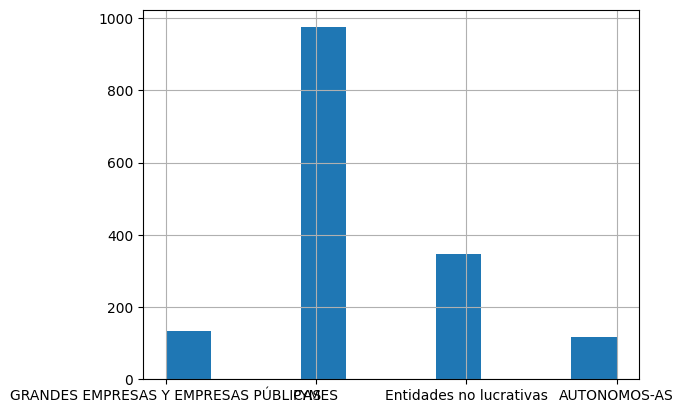

In [238]:
df["tipo_organizacion"].hist() # Distribucion de los tipos de organizaciones 

In [239]:
df["nombre_organizacion"].value_counts()

nombre_organizacion
Sin respuesta                                            3
GRUPO ARAMARK                                            2
CONNEXA SOSTENIBILIDAD Y DIGITALIZACIÓN S.L.             2
EL CORTE INGLÉS S.A.                                     1
BARNIZADOS BARME S.L.                                    1
                                                        ..
AUTOCARES MONSEGUR SL                                    1
EMBOU NUEVAS TECNOLOGÍAS, S.L                            1
Estudio Blu                                              1
Mario Galán Barrado - Arquitecto Técnico / Aparejador    1
Eduardo Fernández Herrero                                1
Name: count, Length: 1569, dtype: int64

In [240]:
df[df["nombre_organizacion"] == "Sin respuesta"]

,id_cliente,id_formulario,tipo_organizacion,nombre_organizacion,direccion,sector_actividad,year,empleados,persona_contacto,email_contacto,pagina_web,impacto_actividad,prioridad mediambiental,mejora
427,1827,7.pdf,GRANDES EMPRESAS Y EMPRESAS PÚBLICAS,Sin respuesta,Sin respuesta,Sin respuesta,Sin respuesta,Sin respuesta,Sin respuesta,Sin respuesta,Sin respuesta,Sin respuesta 32.1. Información adicional Sin ...,NaN,Sin respuesta
956,3083,6.pdf,PYMES,Sin respuesta,CTRA. COGULLADA 8 50014-ZARAGOZA,DISTRIBUCION DE MATERIAL ELECCTRICO Y ELECTRO...,1976,28,RAUL PINA,raulpina@elektraaragon.com,https://www.grupoelektra.es/es/el-grupo/empres...,Se evalúa el impacto ambiental y se ha desarro...,8.0,Tener un plan concreto con un presupuesto asig...
1521,92,7.pdf,GRANDES EMPRESAS Y EMPRESAS PÚBLICAS,Sin respuesta,Sin respuesta,Sin respuesta,Sin respuesta,Sin respuesta,Sin respuesta,Sin respuesta,Sin respuesta,Sin respuesta 32.1. Información adicional Sin ...,NaN,Sin respuesta


In [241]:
# la linea 92 con formularios erroneos de la empresa 1827 formulario 6, por lo que los eliminamos:
indices_to_drop = [1521,427]
df.drop(index=indices_to_drop, inplace=True)
# la linea 3083 no tiene rellenado el nombre de organizacion pero viendo el formulario tenemos que es ELEKTRA ARAGÓN XXI, S.L. por lo que lo rellenamos manualmente:
df.loc[956, "nombre_organizacion"] = "ELEKTRA ARAGÓN XXI, S.L."

In [242]:
df["direccion"].value_counts().sort_values(ascending=True)

direccion
Plaza Las Escuelas 2 y 3 44550 Alcorisa - Teruel                               1
POLIGONO INDUSTRIAL SAN VALERO, NAVES 78, 79 y 83 - 50013 - ZARAGOZA           1
COSO 33, 2º (PLAZA ESPAÑA) 50003 - ZARAGOZA                                    1
AVDA JOSÉ ATARES 113 50018 ZARAGOZA                                            1
C/Barcelona 21 50010 Zaragoza.                                                 1
                                                                              ..
AVDA. PIRINEOS, 67 22300 BARBASTRO                                             2
Calle Bari 57, Edificio TIC XXI (Plaza) 50.197, Zaragoza, España               2
POLÍGONO EL PORTAZGO NAVE 71B, 50.011, ZARAGOZA                                2
C/ Balbino Orensanz 55, Zaragoza                                               2
Polígono Valdeconsejo, C/Aneto 8F Nave 2, 50.410 Cuarte de Huerva, Zaragoza    2
Name: count, Length: 1561, dtype: int64

In [243]:
df[df["direccion"] == "Sin respuesta"]

,id_cliente,id_formulario,tipo_organizacion,nombre_organizacion,direccion,sector_actividad,year,empleados,persona_contacto,email_contacto,pagina_web,impacto_actividad,prioridad mediambiental,mejora
1512,905,6.pdf,PYMES,"ZEUMAT, SL",Sin respuesta,Sin respuesta,Sin respuesta,Sin respuesta,Sin respuesta,Sin respuesta,Sin respuesta,Sin respuesta 29.1. Información adicional. Sin...,NaN,Sin respuesta


In [244]:
# Cliente duplicado en la linea 905, el correcto es 911, 
df.drop(index=1512, inplace=True)

In [245]:
len(df["direccion"].unique())

1560

In [246]:
print(df.info())  # Revisa cuántos valores tiene la columna "direccion"


<class 'pandas.core.frame.DataFrame'>
Index: 1570 entries, 0 to 1572
Data columns (total 14 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id_cliente               1570 non-null   int32  
 1   id_formulario            1570 non-null   object 
 2   tipo_organizacion        1570 non-null   object 
 3   nombre_organizacion      1570 non-null   object 
 4   direccion                1570 non-null   object 
 5   sector_actividad         1568 non-null   object 
 6   year                     1570 non-null   object 
 7   empleados                1454 non-null   object 
 8   persona_contacto         1541 non-null   object 
 9   email_contacto           1560 non-null   object 
 10  pagina_web               1565 non-null   object 
 11  impacto_actividad        1570 non-null   object 
 12  prioridad mediambiental  1568 non-null   float64
 13  mejora                   1559 non-null   object 
dtypes: float64(1), int32(1), obje

In [247]:
print(df["direccion"].dtype)


object


In [248]:
# Utilizamos opencage para localizar las coordenadas latitud y longitud de las direcciones 
# y lo guardamos en un cuaderno json para no tener que gastar los creditos ya que es un recurso de pago.
# quedan direcciones que no localiza por falta de datos

from opencage.geocoder import OpenCageGeocode
import json

#key = 'c8631658aa1d4f688649d97490bfdb23'
key = '868719c58b7843de8591665f0e53848f'
geocoder = OpenCageGeocode(key)

# Ruta del archivo donde guardar los resultados
cache_file = '../utils/geocoding_cache.json' # Ojo cuando cambie de ubi

import os
import json
import re
from opencage.geocoder import OpenCageGeocode
import pandas as pd
import time

def geocode_addresses(df, key, cache_file):
    geocoder = OpenCageGeocode(key)

    # Cargar caché existente
    if os.path.exists(cache_file):
        with open(cache_file, "r") as f:
            cache = json.load(f)
    else:
        cache = {}

    # Inicializar columnas de latitud y longitud
    df["latitud"] = None
    df["longitud"] = None

    for i in df.index:
        try:
            # Verificar si la dirección es válida
            query = str(df.loc[i, "direccion"])
            if pd.isnull(query) or query.strip() == "":
                print(f"Dirección vacía para id_cliente: {df.loc[i, 'id_cliente']}")
                continue

            # Verificar caché para la dirección completa
            if query in cache:
                df.at[i, "latitud"] = cache[query]["lat"]
                df.at[i, "longitud"] = cache[query]["lng"]
                continue

            # Realizar consulta a OpenCage
            results = geocoder.geocode(query)
            if results:
                lat = results[0]["geometry"]["lat"]
                lng = results[0]["geometry"]["lng"]
                df.at[i, "latitud"] = lat
                df.at[i, "longitud"] = lng
                cache[query] = {"lat": lat, "lng": lng}
                continue

            # Si no hay resultados, intentar con el código postal
            match = re.search(r"\b(50\d{3}|22\d{3}|44\d{3})\b", query)
            if match:
                postal_code = match.group(0)
                query_postal = f"{postal_code}, Spain"

                if query_postal in cache:
                    df.at[i, "latitud"] = cache[query_postal]["lat"]
                    df.at[i, "longitud"] = cache[query_postal]["lng"]
                else:
                    results_postal = geocoder.geocode(query_postal)
                    if results_postal:
                        lat = results_postal[0]["geometry"]["lat"]
                        lng = results_postal[0]["geometry"]["lng"]
                        df.at[i, "latitud"] = lat
                        df.at[i, "longitud"] = lng
                        cache[query_postal] = {"lat": lat, "lng": lng}
                    else:
                        print(f"No se encontraron coordenadas: {df.loc[i, 'id_cliente']} - {query_postal}")
            else:
                print(f"Dirección sin código postal: {df.loc[i, 'id_cliente']} - {query}")

            # Pausa entre consultas para evitar límites de velocidad
            time.sleep(1)

        except Exception as e:
            print(f"Error procesando id_cliente {df.loc[i, 'id_cliente']}: {e}")

    # Guardar caché actualizada
    with open(cache_file, "w") as f:
        json.dump(cache, f, indent=4)

    return df


In [249]:
df_actualizado = geocode_addresses(df, key, cache_file) # direcciones no localizadas por falta de datos o errores en codigo postal
# como son 21 casos se busca manualmente y completaremos el cuaderno json con los codigos postales para simplificar

Dirección sin código postal: 1226 - Parque Científico Tecnológico Aula Dei. Polígono Valdeferrín, Edificio EXION. Locales 5 - 6
Dirección sin código postal: 1601 - Calle San Jorge, nº 7, pral.
Dirección sin código postal: 1645 - C/ Barrioverde, nº 10, local  y C/ Blanca de Navarra 2, local
Dirección sin código postal: 1674 - Plaza Cataluña oficinas
Dirección sin código postal: 1744 - CALLE DEL PARQUE, 2. 3º DCHA.
Dirección sin código postal: 2100 - CL JERONIMO ZURITA Nº17 ENTRESUELO DERECHA
Dirección sin código postal: 2209 - C/ 7 de febrero de 1882, num 2 local PIRINEUM
Dirección sin código postal: 2397 - PASEO ECHEGARAY Y CABALLERO 122, LOCAL
Dirección sin código postal: 253 - Calle Río Duero 13 Local
Dirección sin código postal: 2680 - Pol. Ind. Malpica, Calle D, Nº 65
Dirección sin código postal: 2683 - Paseo Constitución 43 bajo derecho
Dirección sin código postal: 2759 - As de Pisos  C/ San Ignacio de Loyola nº4 Local Zaragoza
Dirección sin código postal: 2831 - CALLE LA ENCINA N

In [250]:
import json

# Cargar el archivo JSON
with open(cache_file, 'r') as f:
    data = json.load(f)

# Verificar el tipo de datos y contar elementos
if isinstance(data, list):  # Si el JSON es una lista
    print(f"El JSON contiene {len(data)} elementos en la lista.")
elif isinstance(data, dict):  # Si el JSON es un diccionario
    print(f"El JSON contiene {len(data.keys())} claves en el diccionario.")
else:
    print("El archivo JSON tiene una estructura desconocida.")

El JSON contiene 3144 claves en el diccionario.


In [251]:
df_actualizado[df_actualizado["id_cliente"]== 1300]["direccion"]

147    Academia General Militar Carretera de Huesca s...
Name: direccion, dtype: object

In [252]:
df_actualizado["latitud"].value_counts(dropna=False)

latitud
41.656100    376
32.502700     45
42.136200     30
NaN           21
41.594700     20
            ... 
41.600007      1
41.592775      1
40.390605      1
41.668988      1
41.637743      1
Name: count, Length: 760, dtype: int64

In [253]:
# Filtrar las direcciones erróneas
direcciones_erroneas_df = df_actualizado[df_actualizado["latitud"].isna()][["id_cliente", "direccion"]]

# Convertir el DataFrame en un diccionario
direcciones_erroneas = direcciones_erroneas_df.set_index("id_cliente")["direccion"].to_dict()

# Mostrar el resultado
len(direcciones_erroneas)


21

In [254]:
direcciones_erroneas

{1226: 'Parque Científico Tecnológico Aula Dei. Polígono Valdeferrín, Edificio EXION. Locales 5 - 6',
 1601: 'Calle San Jorge, nº 7, pral.',
 1645: 'C/ Barrioverde, nº 10, local  y C/ Blanca de Navarra 2, local',
 1674: 'Plaza Cataluña oficinas',
 1744: 'CALLE DEL PARQUE, 2. 3º DCHA.',
 2100: 'CL JERONIMO ZURITA Nº17 ENTRESUELO DERECHA',
 2209: 'C/ 7 de febrero de 1882, num 2 local PIRINEUM',
 2397: 'PASEO ECHEGARAY Y CABALLERO 122, LOCAL',
 253: 'Calle Río Duero 13 Local',
 2680: 'Pol. Ind. Malpica, Calle D, Nº 65',
 2683: 'Paseo Constitución 43 bajo derecho',
 2759: 'As de Pisos  C/ San Ignacio de Loyola nº4 Local Zaragoza',
 2831: 'CALLE LA ENCINA Nº4, 50.171 LA PUEBLA DE ALFINÉN (ZARAGOZA)',
 3032: 'C/ZURITA ,7 PRINCIPAL DERECHA Y C/ZURITA, 10',
 3087: 'ED. DR. JOAQUIN REPOLLÉS - TECHNOPARK',
 494: 'AVDA. JUAN PABLO II 40 LOCAL',
 585: 'Parque Tecnológico Walqa - Edificio Ramón y Cajal  220197 - Cuarte (Huesca)',
 623: 'C/ FUENTES ALTAS NÚM.8',
 840: 'C/ LA CADENA, 10 - LOCAL',
 94

In [255]:
df_actualizado[df_actualizado["id_cliente"]==952
               
               
               
               ]

,id_cliente,id_formulario,tipo_organizacion,nombre_organizacion,direccion,sector_actividad,year,empleados,persona_contacto,email_contacto,pagina_web,impacto_actividad,prioridad mediambiental,mejora,latitud,longitud
1536,952,9.pdf,Entidades no lucrativas,FUNDACIÓN PARA EL ESTUDIO Y PROMOCIÓN DE LA AC...,C/ Cabezo Buenavista Nº7 Local,Gestión de Servicios Sociales,2002,759,JAVIER PINTOR NAVARRO,calidad@fepas.org,www.fepas.org,Se evalúa el impacto ambiental y se ha desarro...,8.0,Una posible área de mejora para FEPAS podría s...,None,None


In [256]:
# Diccionario con los id_cliente y sus códigos postales corregidos manualmente
codigos_postales_correcciones = {
    1226: "50600",
    1601: "50001",
    1645: "50010",
    1674: "50001",
    1744: "22002",
    2100: "50001",
    2209: "22700",
    2397: "50001",
    253: "50003",
    2680: "50016",
    2683: "50001",
    2759: "50008", 
    2831: "50171",
    3032: "50001",
    3087: "44600",
    494: "50009",
    585: "22197",
    623: "44556",
    840: "50001",
    943: "50014",
    952: "50001"
}

# Añadir manualmente los códigos postales al DataFrame
for id_cliente, codigo_postal in codigos_postales_correcciones.items():
    # Localizar la fila por el id_cliente y asignar el código postal manualmente
    if id_cliente in df_actualizado["id_cliente"].values:
        df_actualizado.loc[df_actualizado["id_cliente"] == id_cliente, "direccion"] = codigo_postal

# Verificar las filas actualizadas
print(df_actualizado[df_actualizado["id_cliente"].isin(codigos_postales_correcciones.keys())][["id_cliente", "direccion"]])


      id_cliente direccion
100         1226     50600
309         1601     50001
340         1645     50010
356         1674     50001
380         1744     22002
544         2100     50001
584         2209     22700
686         2397     50001
728          253     50003
766         2680     50016
769         2683     50001
814         2759     50008
851         2831     50171
925         3032     50001
959         3087     44600
1277         494     50009
1343         585     22197
1362         623     44556
1473         840     50001
1533         943     50014
1536         952     50001


In [257]:
df_actualizado.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1570 entries, 0 to 1572
Data columns (total 16 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id_cliente               1570 non-null   int32  
 1   id_formulario            1570 non-null   object 
 2   tipo_organizacion        1570 non-null   object 
 3   nombre_organizacion      1570 non-null   object 
 4   direccion                1570 non-null   object 
 5   sector_actividad         1568 non-null   object 
 6   year                     1570 non-null   object 
 7   empleados                1454 non-null   object 
 8   persona_contacto         1541 non-null   object 
 9   email_contacto           1560 non-null   object 
 10  pagina_web               1565 non-null   object 
 11  impacto_actividad        1570 non-null   object 
 12  prioridad mediambiental  1568 non-null   float64
 13  mejora                   1559 non-null   object 
 14  latitud                  1549

In [258]:
# aplicamos de nuevo la funcion pra localizar las coordenadas de las 21 direcciones restantes
df_actualizado_2 = geocode_addresses(df_actualizado, key, cache_file)

In [259]:
df_actualizado_2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1570 entries, 0 to 1572
Data columns (total 16 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id_cliente               1570 non-null   int32  
 1   id_formulario            1570 non-null   object 
 2   tipo_organizacion        1570 non-null   object 
 3   nombre_organizacion      1570 non-null   object 
 4   direccion                1570 non-null   object 
 5   sector_actividad         1568 non-null   object 
 6   year                     1570 non-null   object 
 7   empleados                1454 non-null   object 
 8   persona_contacto         1541 non-null   object 
 9   email_contacto           1560 non-null   object 
 10  pagina_web               1565 non-null   object 
 11  impacto_actividad        1570 non-null   object 
 12  prioridad mediambiental  1568 non-null   float64
 13  mejora                   1559 non-null   object 
 14  latitud                  1570

In [260]:
df_actualizado_2["sector_actividad"].value_counts(dropna=False).sort_values(ascending=True) # aplicar LENGUAJE NATURAL vectorizar y reduciremos con pca

sector_actividad
CONSTRUCCIÓN, INSTALACIONES ELÉCTRICAS                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                 1
Desarrollo rural.  Gestión del programa Leader. Ámbito Comarca de los Monegros.                                                                                                                                                                                                                                                               

In [261]:
df_actualizado_2["year"].value_counts(dropna="False").sort_values(ascending=False)

year
2014                                                                                       43
2019                                                                                       42
2016                                                                                       39
2007                                                                                       36
2002                                                                                       33
                                                                                           ..
Año de constitución: 2012.                                                                  1
1898                                                                                        1
20/01/2010                                                                                  1
La Mafia Franchises, S.L comenzó su actividad en el sector de la Restauración en el año     1
1960 Empresa fundada como titular de persona física D. 

In [262]:


# Función para detectar el primer año válido en diferentes formatos
# Función para limpiar puntos y extraer el primer año de 4 dígitos
def detectar_year(texto):
    if not texto or not isinstance(texto, str):  # Validar que el valor no sea nulo o no sea cadena
        return None
    # Quitar puntos de los números, como transformar "1.996" en "1996"
    texto_limpio = re.sub(r'(\d+)\.(\d+)', r'\1\2', texto)
    # Patrón para encontrar el primer año de 4 dígitos
    patron_year = r'\b(15\d{2}|16\d{2}|17\d{2}|18\d{2}|19\d{2}|20\d{2})\b'
    match = re.search(patron_year, texto_limpio)
    if match:
        return match.group(1)
    return None



In [263]:
# Aplicar la función al DataFrame y crear la nueva columna 'year_2'
df_actualizado_2["year_2"] = df_actualizado_2["year"].apply(detectar_year)

In [264]:
valores_unicos = df_actualizado_2["year_2"].astype(str).unique()
valores_erroneos = [y for y in valores_unicos if not re.fullmatch(r"\d{4}", str(y))]
valores_unicos


array(['1941', '1985', '2010', '1953', '1982', '1999', '1910', '1990',
       'None', '2018', '1958', '1975', '2016', '1995', '2009', '1964',
       '1997', '1977', '1993', '1996', '2015', '2013', '1944', '1962',
       '2004', '1991', '2014', '1989', '2006', '2005', '2003', '2001',
       '1983', '2000', '2017', '2011', '1998', '2007', '1981', '2012',
       '1966', '1929', '2008', '1961', '1984', '1965', '1952', '1946',
       '2002', '1992', '1956', '1986', '1979', '1954', '1967', '1974',
       '1980', '1963', '1968', '1978', '1723', '1925', '1969', '1876',
       '1988', '1927', '1987', '1899', '1905', '2019', '1994', '1931',
       '1912', '1900', '1948', '1934', '2023', '1886', '1971', '1957',
       '2020', '1960', '1945', '1903', '1950', '1935', '1972', '1940',
       '2022', '1973', '1874', '1959', '1943', '1947', '2021', '1955',
       '1976', '1870', '1951', '1922', '1926', '1852', '1868', '1970',
       '1949', '2024', '1933', '1828', '1915', '1918', '1881', '1907',
      

In [265]:
import pandas as pd

# Asegurar que pandas muestra todo el contenido de las celdas
pd.set_option("display.max_colwidth", None)  # Muestra contenido completo en las celdas
pd.set_option("display.max_rows", None)  # Muestra todas las filas

# Filtrar las filas donde 'year_2' tiene valores nulos (None o NaN)
resultado = df_actualizado_2[df_actualizado_2["year_2"].isna()][["id_cliente", "year", "year_2"]]

# Mostrar el resultado
resultado


,id_cliente,year,year_2
9,1014,30/01/83,None
16,1051,HISTORIA,None
61,1156,"QUÍMICA DEL CINCA, S.L. es una empresa vinculada en el GRUPO SERUSAN,",None
103,1230,Nació como Asociación de Desarrollo Comunitario en Áreas de Aragón (ADCARA) el 24 de,None
186,136,T&Z Formación S.L. (System Zaragoza) inicia su actividad en Zaragoza en Septiembre de,None
205,1446,"Comenzó la actividad en la década de los 60, contamos con más de 50 años de",None
211,1457,La Sociedad Municipal Zaragoza Vivienda SLU. tiene su primer antecedente en el,None
256,1525,"La entidad tiene su origen bajo la denominación ASOCIACIÓN MANCALA, en Zaragoza,",None
304,1592,EL GRUPO EMPRESARIAL (INSTALACIONES LOPEZ) AL CUAL PERTENECE LA,None
359,169,Años de empresas anteriores:,None


In [266]:
# Diccionario con los id_cliente y sus códigos postales corregidos manualmente
fechas_correcciones = {1014: '1983',
 1051: '2005',
 1156: '1980',
 1230: '1994',
 136: '1996',
 1446: '1960',
 1457: '1960',
 1525: '1955',
 1592: '1976',
 169: '1998',
 1955: None,
 2391: '1990',
 2874: '1994',
 3236: '2014',
 3324: '2019',
 3338: '1994',
 3417: '1948',
 346: '2007',
 3522: '2020',
 465: '1969',
 542: '1975',
 548: '1992',
 660: '1962',
 696: None,
 960: '2000'}

# Añadir manualmente los códigos postales al DataFrame
for id_cliente, fecha in fechas_correcciones.items():
    # Localizar la fila por el id_cliente y asignar el código postal manualmente
    if id_cliente in df_actualizado_2["id_cliente"].values:
        df_actualizado_2.loc[df_actualizado_2["id_cliente"] == id_cliente, "year_2"] = fecha

# Verificar las filas actualizadas
print(df_actualizado_2[df_actualizado_2["id_cliente"].isin(fechas_correcciones.keys())][["id_cliente", "year_2"]])

      id_cliente year_2
9           1014   1983
16          1051   2005
61          1156   1980
103         1230   1994
186          136   1996
205         1446   1960
211         1457   1960
256         1525   1955
304         1592   1976
359          169   1998
514         1955   None
681         2391   1990
871         2874   1994
1052        3236   2014
1084        3324   2019
1085        3338   1994
1109        3417   1948
1141         346   2007
1189        3522   2020
1258         465   1969
1316         542   1975
1320         548   1992
1382         660   1962
1400         696   None
1543         960   2000


In [267]:
# Convertir valores no numéricos como "desconocido" en NaN para que sean ignorados al calcular la media
# Convertir valores no numéricos en NaN para calcular la media
df_actualizado_2['year_2'] = pd.to_numeric(df_actualizado_2['year_2'], errors='coerce')

# Calcular la media ignorando los NaN
media = df_actualizado_2['year_2'].mean()

# Reemplazar "desconocido" o valores NaN por la media calculada
df_actualizado_2['year_2'] = df_actualizado_2['year_2'].fillna(media)



In [268]:
df_actualizado_2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1570 entries, 0 to 1572
Data columns (total 17 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id_cliente               1570 non-null   int32  
 1   id_formulario            1570 non-null   object 
 2   tipo_organizacion        1570 non-null   object 
 3   nombre_organizacion      1570 non-null   object 
 4   direccion                1570 non-null   object 
 5   sector_actividad         1568 non-null   object 
 6   year                     1570 non-null   object 
 7   empleados                1454 non-null   object 
 8   persona_contacto         1541 non-null   object 
 9   email_contacto           1560 non-null   object 
 10  pagina_web               1565 non-null   object 
 11  impacto_actividad        1570 non-null   object 
 12  prioridad mediambiental  1568 non-null   float64
 13  mejora                   1559 non-null   object 
 14  latitud                  1570

In [269]:
df_actualizado_2["empleados"].value_counts(dropna="False").sort_values(ascending=False)

empleados
2                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                             

In [270]:
# Función para detectar trabajadores
def detectar_trabajadores(texto):
    if not texto or not isinstance(texto, str):  # Validar que el valor no sea nulo o no sea cadena
        return None
    # Quitar puntos de los números, como transformar "1.996" en "1996"
    texto_limpio = re.sub(r'(\d+)\.(\d+)', r'\1\2', texto)
    # Patrón para encontrar el primer numero
    patron_trabajadores = r'\b(\d+)\b'
    match = re.search(patron_trabajadores, texto_limpio)
    # if match:
    #     return match.group(1)
    # return None
    numeros_encontrados = re.findall(patron_trabajadores, texto_limpio)
    return numeros_encontrados

In [271]:
# Crear la columna 'empleados_2' si no existe
if 'empleados_2' not in df_actualizado_2.columns:
    df_actualizado_2['empleados_2'] = None

for i in range(len(df_actualizado_2)):
    if df_actualizado_2.iloc[i]["tipo_organizacion"] == "AUTONOMOS-AS":
        df_actualizado_2.iloc[i, df_actualizado_2.columns.get_loc("empleados_2")] = 1
    else: 
        # Detectar el número de trabajadores usando la función y asignarlo a empleados_2
        trabajadores = detectar_trabajadores(df_actualizado_2.iloc[i]["empleados"])
        if trabajadores:
            df_actualizado_2.iloc[i, df_actualizado_2.columns.get_loc("empleados_2")] = trabajadores[0]
        else:
            df_actualizado_2.iloc[i, df_actualizado_2.columns.get_loc("empleados_2")] = None


In [272]:
df_empleados_erroneos = df_actualizado_2[df_actualizado_2["empleados_2"].isnull()][["id_cliente", "empleados", "empleados_2"]]
df_empleados_erroneos

,id_cliente,empleados,empleados_2
9,1014,"Tres personas contratadas de continuo, subcontratacion según demanda de trabajo.",None
17,1054,EMPLEADAS : NINGUNA.\n.,None
69,1171,Dos personas de manera intermitente,None
133,1286,"Una persona empleada cotizando en régimen de artistas, se le contrata para las\nactuaciones, ensayos, etc. En ocasiones dos o tres personas contratadas, dependiendo de\nla necesidad de la producción.",None
161,1326,Seis,None
173,1343,"En estos momentos no existen personas empleadas directamente en la empresa, existen\ndiversos colaboradores habituales.",None
174,1344,"En la actualidad en nómina,solo tenemos un empleado",None
177,1348,Dos,None
183,1357,"Actualmente la Asociación cuenta con cinco trabajadoras; una trabajadora social, una\nmaestra en educación especial, una fisioterapeuta, una coordinadora y técnico\nadministrativo (persona con discapacidad física) y una psicóloga.",None
214,1461,EL PERSONAL ES VOLUNTARIO. ACTUALMENTE NO HAY EMPLEADOS,None


In [273]:
df_actualizado_2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1570 entries, 0 to 1572
Data columns (total 18 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id_cliente               1570 non-null   int32  
 1   id_formulario            1570 non-null   object 
 2   tipo_organizacion        1570 non-null   object 
 3   nombre_organizacion      1570 non-null   object 
 4   direccion                1570 non-null   object 
 5   sector_actividad         1568 non-null   object 
 6   year                     1570 non-null   object 
 7   empleados                1454 non-null   object 
 8   persona_contacto         1541 non-null   object 
 9   email_contacto           1560 non-null   object 
 10  pagina_web               1565 non-null   object 
 11  impacto_actividad        1570 non-null   object 
 12  prioridad mediambiental  1568 non-null   float64
 13  mejora                   1559 non-null   object 
 14  latitud                  1570

In [274]:
empleados_correcciones = {}
for index, row in df_empleados_erroneos.iterrows():
    empleados_correcciones[row['id_cliente']] = row['empleados']

In [275]:
empleados_correcciones

{1014: 'Tres personas contratadas de continuo, subcontratacion según demanda de trabajo.',
 1054: 'EMPLEADAS : NINGUNA.\n.',
 1171: 'Dos personas de manera intermitente',
 1286: 'Una persona empleada cotizando en régimen de artistas, se le contrata para las\nactuaciones, ensayos, etc. En ocasiones dos o tres personas contratadas, dependiendo de\nla necesidad de la producción.',
 1326: 'Seis',
 1343: 'En estos momentos no existen personas empleadas directamente en la empresa, existen\ndiversos colaboradores habituales.',
 1344: 'En la actualidad en nómina,solo tenemos un empleado',
 1348: 'Dos',
 1357: 'Actualmente la Asociación cuenta con cinco trabajadoras; una trabajadora social, una\nmaestra en educación especial, una fisioterapeuta, una coordinadora y  técnico\nadministrativo (persona con discapacidad física)  y una psicóloga.',
 1461: 'EL PERSONAL ES VOLUNTARIO. ACTUALMENTE NO HAY EMPLEADOS',
 1462: 'NINGUNA.',
 1495: 'TRES',
 1586: 'Sin respuesta',
 1644: 'DOS PERSONAS',
 1658: '

In [276]:
{1014: '3',
 1054: '0',
 1171: '2',
 1286: '3',
 1326: '6',
 1343: '0',
 1344: '1',
 1348: '2',
 1357: '5',
 1461: '0',
 1462: '0',
 1495: '3',
 1586: '0',
 1644: '2',
 1658: '0',
 1729: '0',
 1779: '0',
 1782: '0',
 1840: '0',
 1864: '0',
 1884: '0',
 1907: '3',
 1919: '4',
 1923: '0',
 1951: '0',
 1952: '15',
 1971: '6',
 2126: '1',
 2129: '4',
 2233: '8',
 2291: '2',
 2315: '12',
 2392: '0',
 2678: '11',
 2703: '18',
 2706: '0',
 2708: '0',
 2820: '3',
 2915: '0',
 2921: '3',
 3050: '3',
 3068: '9',
 3087: '5',
 3107: '0',
 3111: '0',
 3114: '1',
 3151: '2',
 3157: '2',
 3158: '9',
 3165: '1',
 3201: '0',
 3230: '1',
 3256: '2',
 3396: '0',
 3411: '0',
 3429: '8',
 346: '14',
 3522: '5',
 461: '0',
 508: '0',
 559: '11',
 580: '20',
 639: '2',
 753: '0',
 906: '4',
 926: '5'}

{1014: '3',
 1054: '0',
 1171: '2',
 1286: '3',
 1326: '6',
 1343: '0',
 1344: '1',
 1348: '2',
 1357: '5',
 1461: '0',
 1462: '0',
 1495: '3',
 1586: '0',
 1644: '2',
 1658: '0',
 1729: '0',
 1779: '0',
 1782: '0',
 1840: '0',
 1864: '0',
 1884: '0',
 1907: '3',
 1919: '4',
 1923: '0',
 1951: '0',
 1952: '15',
 1971: '6',
 2126: '1',
 2129: '4',
 2233: '8',
 2291: '2',
 2315: '12',
 2392: '0',
 2678: '11',
 2703: '18',
 2706: '0',
 2708: '0',
 2820: '3',
 2915: '0',
 2921: '3',
 3050: '3',
 3068: '9',
 3087: '5',
 3107: '0',
 3111: '0',
 3114: '1',
 3151: '2',
 3157: '2',
 3158: '9',
 3165: '1',
 3201: '0',
 3230: '1',
 3256: '2',
 3396: '0',
 3411: '0',
 3429: '8',
 346: '14',
 3522: '5',
 461: '0',
 508: '0',
 559: '11',
 580: '20',
 639: '2',
 753: '0',
 906: '4',
 926: '5'}

In [277]:
# # Diccionario con los id_cliente y empleados corregidos manualmente, si no se aporta y no se valorara relevante se pone a 0
empleados_correcciones = {1014: '3',
 1054: '0',
 1171: '2',
 1286: '3',
 1326: '6',
 1343: '0',
 1344: '1',
 1348: '2',
 1357: '5',
 1461: '0',
 1462: '0',
 1495: '3',
 1586: '0',
 1644: '2',
 1658: '0',
 1729: '0',
 1779: '0',
 1782: '0',
 1840: '0',
 1864: '0',
 1884: '0',
 1907: '3',
 1919: '4',
 1923: '0',
 1951: '0',
 1952: '15',
 1971: '6',
 2126: '1',
 2129: '4',
 2233: '8',
 2291: '2',
 2315: '12',
 2392: '0',
 2678: '11',
 2703: '18',
 2706: '0',
 2708: '0',
 2820: '3',
 2915: '0',
 2921: '3',
 3007: '0',
 3050: '3',
 3068: '9',
 3087: '5',
 3107: '0',
 3111: '0',
 3114: '1',
 3151: '2',
 3157: '2',
 3158: '9',
 3165: '1',
 3201: '0',
 3230: '1',
 3256: '2',
 3396: '0',
 3411: '0',
 3429: '8',
 346: '14',
 3522: '5',
 461: '0',
 508: '0',
 559: '11',
 580: '20',
 639: '2',
 753: '0',
 906: '4',
 926: '5'}

# Añadir manualmente los empleados al DataFrame, la mayoria datos en letra
for id_cliente, empleados in empleados_correcciones.items():
    # Localizar la fila por el id_cliente y asignar el código postal manualmente
    if id_cliente in df_actualizado_2["id_cliente"].values:
        df_actualizado_2.loc[df_actualizado_2["id_cliente"] == id_cliente, "empleados_2"] = empleados

# Verificar las filas actualizadas
print(df_actualizado_2[df_actualizado_2["id_cliente"].isin(empleados_correcciones.keys())][["id_cliente", "empleados_2"]])

      id_cliente empleados_2
9           1014           3
17          1054           0
69          1171           2
133         1286           3
161         1326           6
173         1343           0
174         1344           1
177         1348           2
183         1357           5
214         1461           0
215         1462           0
238         1495           3
299         1586           0
339         1644           2
347         1658           0
371         1729           0
399         1779           0
403         1782           0
437         1840           0
453         1864           0
466         1884           0
482         1907           3
490         1919           4
493         1923           0
510         1951           0
511         1952          15
523         1971           6
550         2126           1
553         2129           4
599         2233           8
632         2291           2
645         2315          12
682         2392           0
765         26

In [278]:
df_actualizado_2[df_actualizado_2["empleados_2"].isnull()]

,id_cliente,id_formulario,tipo_organizacion,nombre_organizacion,direccion,sector_actividad,year,empleados,persona_contacto,email_contacto,pagina_web,impacto_actividad,prioridad mediambiental,mejora,latitud,longitud,year_2,empleados_2


In [279]:
# Los campos nombre-organizacion, direccion, persona contacto, email y pagina web son datos personales que por proteccion de datos eliminamos, pero lo tendremos disponibles.

df_actualizado_3= df_actualizado_2.drop(columns=["nombre_organizacion","direccion","persona_contacto", "email_contacto", "pagina_web"])

In [280]:
df_actualizado_3.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1570 entries, 0 to 1572
Data columns (total 13 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id_cliente               1570 non-null   int32  
 1   id_formulario            1570 non-null   object 
 2   tipo_organizacion        1570 non-null   object 
 3   sector_actividad         1568 non-null   object 
 4   year                     1570 non-null   object 
 5   empleados                1454 non-null   object 
 6   impacto_actividad        1570 non-null   object 
 7   prioridad mediambiental  1568 non-null   float64
 8   mejora                   1559 non-null   object 
 9   latitud                  1570 non-null   object 
 10  longitud                 1570 non-null   object 
 11  year_2                   1570 non-null   float64
 12  empleados_2              1570 non-null   object 
dtypes: float64(2), int32(1), object(10)
memory usage: 197.9+ KB


In [281]:
df_actualizado_3["impacto_actividad"].value_counts() # viendo las dimensiones de este campo de texto, 
#se platea contar las palabras como sintoma de mayor numero palabras mayor efecto medioambiental de la actividad.


impacto_actividad
Se evalúa el impacto ambiental y se llevan a cabo acciones para segregar y reciclar residuos y para reducir el consumo de recursos naturales.  32.1. Información adicional . Compromiso frente al cambio climático 33.- ¿Se participa o se ponen en marcha acciones que evidencien el compromiso público de la organización para prevenir la contaminación? No existen actividades en marcha                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          

In [282]:
df_actualizado_3[df_actualizado_3["impacto_actividad"].isnull()]

,id_cliente,id_formulario,tipo_organizacion,sector_actividad,year,empleados,impacto_actividad,prioridad mediambiental,mejora,latitud,longitud,year_2,empleados_2


In [70]:
df_actualizado_3["prioridad mediambiental"].value_counts().sort_values()
#Priorice la importancia que le otorga a los siguientes aspectos para lograr el éxito
#en la gestión socialmente responsable. (1 más importante - 10 menos importante)
# Trabajar para proteger y mejorar el medio ambiente


prioridad mediambiental
1.0      42
2.0      54
3.0      70
4.0     106
5.0     117
6.0     144
7.0     213
10.0    217
8.0     265
9.0     341
Name: count, dtype: int64

<Axes: >

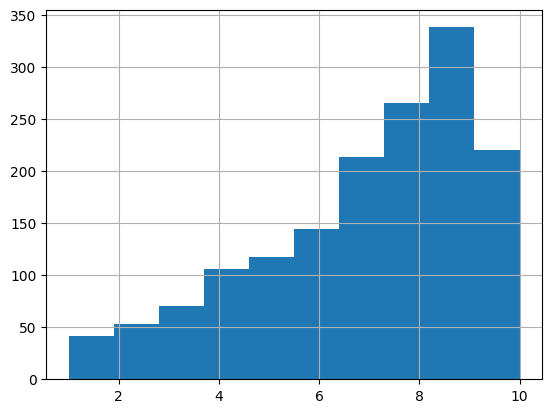

In [283]:
df_actualizado_3["prioridad mediambiental"].hist()

In [284]:
# Consideramos que es una variable relevante para nuestra clasificacion de clientes predispuestos a gestoria medioambiental.
# Planteamos un primer escenario de clasificacion clubtering sin variable target, pero si determinamos que la
# clasificacion es relevante esta variable como pensamos podriamos platear un estudio de modelo supervisado con target prioridad medioambiental
df_actualizado_3[df_actualizado_3["prioridad mediambiental"].isnull()]

,id_cliente,id_formulario,tipo_organizacion,sector_actividad,year,empleados,impacto_actividad,prioridad mediambiental,mejora,latitud,longitud,year_2,empleados_2
509,1950,9.pdf,Entidades no lucrativas,Comunicación,2021,1,Sin respuesta 34.1. Información adicional. Sin respuesta Compromiso frente al cambio climático 35.- ¿Se participa o se ponen en marcha acciones que evidencien el compromiso público de la organización para prevenir la contaminación? Sin respuesta 35.1. Información adicional. Sin respuesta,NaN,Sin respuesta,41.650238,-0.890085,2021.0,1
1505,894,6.pdf,PYMES,Organización sin animo de lucro,2012,5,Sin respuesta 29.1. Información adicional. Sin respuesta Compromiso frente al cambio climático 30.- ¿Se participa o se ponen en marcha acciones que evidencien el compromiso público de la organización para prevenir la contaminación? Sin respuesta 30.1. Información adicional. Sin respuesta,NaN,Sin respuesta,41.658505,-0.887752,2012.0,5


In [285]:
# # asignamos prioridad moda a los que no han rellenado, consultaa realizada a negocio que valora encaja 
moda = df_actualizado_3['prioridad mediambiental'].mode()[0]  # .mode() devuelve un objeto, tomamos el primer valor más frecuente

# # Reemplazar los valores nulos por la moda
# df_actualizado_3['prioridad mediambiental'].fillna(moda, inplace=True)

df_actualizado_3['prioridad mediambiental'] = df_actualizado_3['prioridad mediambiental'].fillna(moda)


In [286]:
df_actualizado_3.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1570 entries, 0 to 1572
Data columns (total 13 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id_cliente               1570 non-null   int32  
 1   id_formulario            1570 non-null   object 
 2   tipo_organizacion        1570 non-null   object 
 3   sector_actividad         1568 non-null   object 
 4   year                     1570 non-null   object 
 5   empleados                1454 non-null   object 
 6   impacto_actividad        1570 non-null   object 
 7   prioridad mediambiental  1570 non-null   float64
 8   mejora                   1559 non-null   object 
 9   latitud                  1570 non-null   object 
 10  longitud                 1570 non-null   object 
 11  year_2                   1570 non-null   float64
 12  empleados_2              1570 non-null   object 
dtypes: float64(2), int32(1), object(10)
memory usage: 197.9+ KB


In [ ]:
# from datetime import datetime

# # Función para manejar cada año
# def format_year(year):
#     year_int = int(year)  # Convertir el año a entero
#     if year_int < 1900:
#         return f"01/01/{year_int}"  # Crear una fecha en formato string
#     else:
#         date_obj = datetime(year_int, 1, 1)
#         return date_obj.strftime("%d/%m/%y")  # Convertir a formato fecha

# # Aplicar la función a la columna year_2
# df_actualizado_3["formateada_fecha"] = df_actualizado_3["year_2"].apply(format_year)




In [ ]:
# revisar nulos

In [287]:
# convertir en numero la columna id_cliente:
df_actualizado_3['empleados_2'] = pd.to_numeric(df_actualizado_3['empleados_2'], errors='coerce').astype('Int64')

In [288]:
df_actualizado_3['prioridad_medioambiental'] = pd.to_numeric(df_actualizado_3['prioridad mediambiental'], errors='coerce').astype('int')

In [ ]:
# que hacemos con nulos

In [ ]:
# revisar nulos mejora, rellenar con sin comentarios

In [289]:
df_actualizado_3['latitud_num'] = pd.to_numeric(df_actualizado_3['latitud'], errors='coerce').astype('float64')

In [290]:
df_actualizado_3['long_num'] = pd.to_numeric(df_actualizado_3['longitud'], errors='coerce').astype('float64')

In [291]:
df_actualizado_3['year_3'] = pd.to_numeric(df_actualizado_3['year_2'], errors='coerce').astype('int')

In [292]:
# Dataframe completado 

df_limpio = df_actualizado_3[["id_cliente",
                              "tipo_organizacion",
                              "sector_actividad",
                              "year_3",
                              "empleados_2", 
                              "impacto_actividad",
                              "prioridad_medioambiental", 
                              "mejora","latitud_num", 
                              "long_num"]]

In [293]:
df_limpio.head()

id_cliente                     tipo_organizacion  \
0        1000  GRANDES EMPRESAS Y EMPRESAS PÚBLICAS   
1        1001                                 PYMES   
2        1002                                 PYMES   
3        1004               Entidades no lucrativas   
4        1005                                 PYMES   

                                                                             sector_actividad  \
0                                                          Sector comercio, grandes almacenes   
1  Consultoría integral de Recursos Humanos: - Selección - Formación - Consultoría y coaching   
2                                                                    FORMACION PARA EL EMPLEO   
3                                                                         Mujer/Acción Social   
4                                                        Instalaciones eléctricas en general.   

   year_3  empleados_2  \
0    1941        81714   
1    1985            8   
2    2010            7   
3    1953            8   
4    1982            4   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                    

In [294]:
df_limpio.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1570 entries, 0 to 1572
Data columns (total 10 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   id_cliente                1570 non-null   int32  
 1   tipo_organizacion         1570 non-null   object 
 2   sector_actividad          1568 non-null   object 
 3   year_3                    1570 non-null   int32  
 4   empleados_2               1570 non-null   Int64  
 5   impacto_actividad         1570 non-null   object 
 6   prioridad_medioambiental  1570 non-null   int32  
 7   mejora                    1559 non-null   object 
 8   latitud_num               1570 non-null   float64
 9   long_num                  1570 non-null   float64
dtypes: Int64(1), float64(2), int32(3), object(4)
memory usage: 150.3+ KB


In [295]:

sin_mejora = "sin_mejora"
df_limpio['mejora'] = df_limpio['mejora'].fillna(sin_mejora)

C:\Users\josel\AppData\Local\Temp\ipykernel_24876\1886465364.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_limpio['mejora'] = df_limpio['mejora'].fillna(sin_mejora)


In [296]:
df_limpio.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1570 entries, 0 to 1572
Data columns (total 10 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   id_cliente                1570 non-null   int32  
 1   tipo_organizacion         1570 non-null   object 
 2   sector_actividad          1568 non-null   object 
 3   year_3                    1570 non-null   int32  
 4   empleados_2               1570 non-null   Int64  
 5   impacto_actividad         1570 non-null   object 
 6   prioridad_medioambiental  1570 non-null   int32  
 7   mejora                    1570 non-null   object 
 8   latitud_num               1570 non-null   float64
 9   long_num                  1570 non-null   float64
dtypes: Int64(1), float64(2), int32(3), object(4)
memory usage: 150.3+ KB


In [297]:
df_actualizado_2[df_actualizado_2["sector_actividad"].isnull()]

,id_cliente,id_formulario,tipo_organizacion,nombre_organizacion,direccion,sector_actividad,year,empleados,persona_contacto,email_contacto,pagina_web,impacto_actividad,prioridad mediambiental,mejora,latitud,longitud,year_2,empleados_2
297,1584,9.pdf,Entidades no lucrativas,Feria de Zaragoza,"Autovía A II, Km. 311 50012 Zaragoza",NaN,1945,61,PILAR MARTÍN GUILLEN,mpmartin@feriazaragoza.es,https://www.feriazaragoza.es/,"Se tiene en cuenta el impacto ambiental ocasionado por la actividad de la organización y se ha llevado a cabo alguna iniciativa de forma puntual e informal. 34.1. Información adicional. Feria de Zaragoza es empresa productora de mezclas de residuos municipales en el CTRUZ (Complejo para Tratamiento de Residuos Urbanos de Zaragoza) con autorización número AR-II-31/2008/68/2009 para una cantidad estimada al año de 1.000 toneladas. En la actualidad los residuos admitidos por el CTRUZ son los siguientes: a.\tPlásticos(envases ligeros de recogida selectiva) b.\tOtras fracciones no especificadas en otra categoría (envases ligeros de recogida selectiva) c.\tResiduos biodegradables (residuos de parques y jardines) d.\tMezcla de residuos municipales e.\tResiduos voluminosos f.\tResiduos municipales no especificados en otra categoría (solo animales domésticos) En el CTRUZ, aunque el acceso del residuo sea de ?todo uno? se produce una separación por productos para su posterior reciclado. Compromiso frente al cambio climático 35.- ¿Se participa o se ponen en marcha acciones que evidencien el compromiso público de la organización para prevenir la contaminación? Se ha participado en alguna iniciativa de forma puntual. 35.1. Información adicional. En la actualidad tenemos implantadas acciones puntuales para conseguir una reducción en la generación de plásticos, papel y de los residuos generados en el recinto. Para ello se esta potenciando la digitalización de procesos, eliminación de botellas de PET y cambio por botellas de cristal y cartón. Reducción y racionalización de los consumos adecuando instalaciones y prácticas de uso, tanto de energía como de otros recursos naturales como agua potable y papel, así como dirigiendo nuestras inversiones a descarbonización y hacia la compra de equipos más eficientes. Entre otros la iluminación led que progresivamente vamos sustituyendo por los anteriores sistemas de iluminación, detectores de presencia en salas/zonas, dosificadores de caudal en grifos de aseos, sistemas inteligentes de control de climatización y alumbrado, para ajustar las necesidades reales a la ocupación, desconexión de alimentadores de corriente al final de la jornada, y configuración de equipos en modo ahorro de energía.",8.0,Gestión medioambiental: Exigir a nuestros proveedores la mejora en su oferta respecto a este tema y poder guiarnos por esto y no por precio,41.6561,-0.8773,1945.0,61
723,2508,6.pdf,PYMES,ELECTRICIDAD MAYASA S.L.,"Polígono Miguel Servet, nave 3. 50013 Zaragoza",NaN,"En 1967, primero como persona física y más tarde como sociedad limitada.",24,Regina Martínez Gracia,regina.martinez@grupomayasa.com,https://www.electricidadmayasa.com,"Se evalúa el impacto ambiental y se llevan a cabo acciones para segregar y reciclar residuos y para reducir el consumo de recursos naturales. 29.1. Información adicional. Tenemos convenios directos con AMBILAMP para la recogida selectiva de materiales de iluminación, con empresas de recogida y gestión de residuos, puntos limpios, etc. Además estamos implantando políticas de compra selectiva. Este año, con la obtención de la certificación ISO 50001:2018, que se basa en la implantación de un sistema de gestión de energía, monitorizamos los consumos energéticos que están implicados en el desempeño energético de la compañía, y establecemos objetivos de mejora. Aunque no es un objetivo en sí relacionado con esta norma ISO, tenemos implantado un proyecto de reducción a tres años de la huella de carbono generada por la empresa, con lo que esperamos contribuir de esta manera a red

In [339]:
# Diccionario con los id_cliente y sus códigos postales corregidos manualmente
codigos_sector_actividad = {
    1584: "Organización de convenciones y ferias de muestras.CNAE: 8230",
    2508: "Instalaciones eléctricas de BAJA TENSIÓN-- Instalaciones especiales- Revisión, reparación y bobinado de motores eléctricos. Construcción de cuadros (pequeñas y grandes series)- Gestión de energía reactiva- Suministro de materiales: consumo o grandes series.- Fabricación y trabajos en taller."
}

# Añadir manualmente los códigos postales al DataFrame
for id_cliente, sector in codigos_sector_actividad.items():
    # Localizar la fila por el id_cliente y asignar el código postal manualmente
    if id_cliente in df_actualizado["id_cliente"].values:
        df_limpio.loc[df_limpio["id_cliente"] == id_cliente, "sector_actividad"] = sector

# Verificar las filas actualizadas
print(df_limpio[df_limpio["id_cliente"].isin(codigos_sector_actividad.keys())][["id_cliente", "sector_actividad"]])

     id_cliente  \
297        1584   
723        2508   

                                                                                                                                                                                                                                                                                         sector_actividad  
297                                                                                                                                                                                                                                          Organización de convenciones y ferias de muestras.CNAE: 8230  
723  Instalaciones eléctricas de BAJA TENSIÓN-- Instalaciones especiales- Revisión, reparación y bobinado de motores eléctricos. Construcción de cuadros (pequeñas y grandes series)- Gestión de energía reactiva- Suministro de materiales: consumo o grandes series.- Fabricación y trabajos en taller.  


In [340]:
df_limpio.info()


<class 'pandas.core.frame.DataFrame'>
Index: 1570 entries, 0 to 1572
Data columns (total 10 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   id_cliente                1570 non-null   int32  
 1   tipo_organizacion         1570 non-null   object 
 2   sector_actividad          1570 non-null   object 
 3   year_3                    1570 non-null   int32  
 4   empleados_2               1570 non-null   Int64  
 5   impacto_actividad         1570 non-null   object 
 6   prioridad_medioambiental  1570 non-null   int32  
 7   mejora                    1570 non-null   object 
 8   latitud_num               1570 non-null   float64
 9   long_num                  1570 non-null   float64
dtypes: Int64(1), float64(2), int32(3), object(4)
memory usage: 150.3+ KB


In [341]:
# Configurar la columna "id_cliente" como índice
df_limpio.set_index("id_cliente", inplace=True)
# Guardamos el dataframe en un archivo csv en la carpeta data_sample
df_limpio.to_csv(r"C:\Users\josel\Thebridge\REPO_ZERO\ML_enviroment_rsa_2025\src\data_sample\datos_rsa_limpio.csv", index=True)

In [342]:
df_limpio = pd.read_csv(r"C:\Users\josel\Thebridge\REPO_ZERO\ML_enviroment_rsa_2025\src\data_sample\datos_rsa_limpio.csv")

In [343]:
df_limpio.head()


id_cliente                     tipo_organizacion  \
0        1000  GRANDES EMPRESAS Y EMPRESAS PÚBLICAS   
1        1001                                 PYMES   
2        1002                                 PYMES   
3        1004               Entidades no lucrativas   
4        1005                                 PYMES   

                                                                             sector_actividad  \
0                                                          Sector comercio, grandes almacenes   
1  Consultoría integral de Recursos Humanos: - Selección - Formación - Consultoría y coaching   
2                                                                    FORMACION PARA EL EMPLEO   
3                                                                         Mujer/Acción Social   
4                                                        Instalaciones eléctricas en general.   

   year_3  empleados_2  \
0    1941        81714   
1    1985            8   
2    2010            7   
3    1953            8   
4    1982            4   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                    

In [344]:
df_limpio.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1570 entries, 0 to 1569
Data columns (total 10 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   id_cliente                1570 non-null   int64  
 1   tipo_organizacion         1570 non-null   object 
 2   sector_actividad          1570 non-null   object 
 3   year_3                    1570 non-null   int64  
 4   empleados_2               1570 non-null   int64  
 5   impacto_actividad         1570 non-null   object 
 6   prioridad_medioambiental  1570 non-null   int64  
 7   mejora                    1570 non-null   object 
 8   latitud_num               1570 non-null   float64
 9   long_num                  1570 non-null   float64
dtypes: float64(2), int64(4), object(4)
memory usage: 122.8+ KB


# APLICACIÓN ML: Procesamiento lenguaje natural NLP
## FASE 1- LIMPIEZA


In [74]:
# Variable objeto a lenguaje natural a limpiar son:
variables_ln = ["sector_actividad", "impacto_actividad", "mejora"]

In [345]:
import re
import unicodedata

# Expresiones regulares para reemplazar caracteres
REPLACE_NO_SPACE = re.compile(r"(\.)|(\;)|(\:)|(\!)|(\?)|(\,)|(\")|(\()|(\))|(\[)(\])|(\d+)")
REPLACE_WITH_SPACE = re.compile(r"(<br \s*/><br\s*/>)|(\-)|(\/)|(_)")

NO_SPACE = ""
SPACE = " "

# Función para eliminar acentos
def remove_accents(input_str):
    nfkd_form = unicodedata.normalize('NFKD', input_str)
    return ''.join([char for char in nfkd_form if not unicodedata.combining(char)])

# Función para limpiar texto
def clean(row):
    # Paso 1: Eliminar acentos
    row = remove_accents(row)

    # Paso 2: Excluir el patrón de CNAE seguido de números antes de limpiar
    match_cnae = re.findall(r'CNAE[:\s]*\d+', row)
    
    # Limpio signos y convierto a minúsculas
    dato = REPLACE_NO_SPACE.sub(NO_SPACE, row.lower())
    
    # Convierto retornos de carro y guiones en espacios
    dato = REPLACE_WITH_SPACE.sub(SPACE, dato)
    
    # Quito cualquier link
    dato = " ".join([word for word in dato.split() if "http" not in word])
    
    # Recupero "CNAE: ####" al texto limpio
    dato = " ".join(match_cnae + dato.split())
    
    return dato



In [346]:
for i in variables_ln:
    df_limpio[i+"_clean"] = df_limpio[i].apply(clean)

In [347]:
variables_ln_clean = ["sector_actividad_clean", "impacto_actividad_clean", "mejora_clean"]

In [348]:
import nltk
nltk.download('popular')

[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to
[nltk_data]    |     C:\Users\josel\AppData\Roaming\nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package gazetteers to
[nltk_data]    |     C:\Users\josel\AppData\Roaming\nltk_data...
[nltk_data]    |   Package gazetteers is already up-to-date!
[nltk_data]    | Downloading package genesis to
[nltk_data]    |     C:\Users\josel\AppData\Roaming\nltk_data...
[nltk_data]    |   Package genesis is already up-to-date!
[nltk_data]    | Downloading package gutenberg to
[nltk_data]    |     C:\Users\josel\AppData\Roaming\nltk_data...
[nltk_data]    |   Package gutenberg is already up-to-date!
[nltk_data]    | Downloading package inaugural to
[nltk_data]    |     C:\Users\josel\AppData\Roaming\nltk_data...
[nltk_data]    |   Package inaugural is already up-to-date!
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]   

True

In [349]:
from nltk.corpus import stopwords
dictionary = stopwords.words("spanish")
import re

def remove_stopwords(row):
    # Expresión regular para detectar "CNAE" seguido de números
    pattern = r'CNAE \d+'
    
    # Divide las palabras y aplica la lógica
    dato = " ".join([word for word in row.split(" ") 
                     if word not in dictionary or re.match(pattern, word)])
    return dato

In [350]:
for i in variables_ln_clean:
    df_limpio[i+"_sin_stopwords"] = df_limpio[i].apply(remove_stopwords)

In [81]:
df_limpio.loc[0]

id_cliente                                                                            1000
tipo_organizacion                                     GRANDES EMPRESAS Y EMPRESAS PÚBLICAS
sector_actividad                                        Sector comercio, grandes almacenes
year_3                                                                                1941
empleados_2                                                                          81714
impacto_actividad                        Se evalúa el impacto ambiental y se ha desarro...
prioridad_medioambiental                                                                 2
mejora                                   Implantación de programas de comunicación global.
latitud_num                                                                      40.425697
long_num                                                                         -3.671087
sector_actividad_clean                                   sector comercio grandes almacenes

In [351]:
df_limpio["impacto_recuento"] = df_limpio["impacto_actividad_clean_sin_stopwords"].apply(lambda x: len(x.split()))
df_limpio["mejora_recuento"] = df_limpio["mejora_clean_sin_stopwords"].apply(lambda x: len(x.split()))

In [352]:
df_limpio.loc[0]

id_cliente                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                              

In [ ]:
# Modelo a utilizar Agrupamiento jerarquico porque es interpretable y funciona bien con conjuntos de datos pequeños como nuestro caso.ç
# tenemos variables numericas y categoricas, este modelo permite con opcion Grower utilizarlas mixto
# posibles problemas tenemos 3 variables con lenguaje natural. tendremos que simpificarlas para evitar exceso de variables
# sector de actividad vamos reducirlo a 5 con pca, en impacto de actividad y mejora probaremos recuento palabras.
# como nuestro modelo utiliza distancia entre puntos es sensible al escalado 


In [353]:
def describe_df(df_origen):
    '''La función recibe un dataframe origen y devuelve un dataframe resultado 
    con información sobre el tipo de dato, valores faltantes, valores únicos y cardinalidad
    
    Argumento: 
    1. Parámetro único: DataFrame a analizar

    Retorna:
    1. Nombre de la variable
    2. Tipo de dato de la variable
    3. Porcentaje de valores nulos de la variable
    4. Número de valores únicos de la variable
    5. Porcentaje de cardinalidad de la variable


    '''
    # Creamos el diccionario para almacenar los resultados de los indicadores:
    resultado = {
        "COL_N": [],
        "DATA_TYPE": [],
        "MISSINGS (%)": [],
        "UNIQUE_VALUES":[],
        "CARDIN (%)": []
    }
    # Rellenamos los valores iterando en las columnas del DataFrame de origen:
    for col in df_origen.columns:
        resultado["COL_N"].append(col)
        resultado["DATA_TYPE"].append(df_origen[col].dtype)
        missings = round(df_origen[col].isna().sum()/len(df_origen)*100, 1)
        resultado["MISSINGS (%)"].append(missings)
        valores_unicos=df_origen[col].nunique()
        resultado["UNIQUE_VALUES"].append(valores_unicos)
        cardinalidad = round((valores_unicos/len(df_origen))*(1-missings/100),2)
        resultado["CARDIN (%)"].append(cardinalidad)
    
    df_resultado = pd.DataFrame(resultado) # convertimos en un DataFrame

    df_resultado.set_index("COL_N", inplace=True) # Establecemos como indices los nombres de las variables


    return df_resultado.T #Trasponemos el DataFrame

In [354]:
describe_df(df_limpio)

COL_N,id_cliente,tipo_organizacion,sector_actividad,year_3,empleados_2,impacto_actividad,prioridad_medioambiental,mejora,latitud_num,long_num,sector_actividad_clean,impacto_actividad_clean,mejora_clean,sector_actividad_clean_sin_stopwords,impacto_actividad_clean_sin_stopwords,mejora_clean_sin_stopwords,impacto_recuento,mejora_recuento
DATA_TYPE,int64,object,object,int64,int64,object,int64,object,float64,float64,object,object,object,object,object,object,int64,int64
MISSINGS (%),0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
UNIQUE_VALUES,1570,4,1468,118,237,1562,10,1524,770,769,1389,1547,1510,1381,1544,1505,313,92
CARDIN (%),1.0,0.0,0.94,0.08,0.15,0.99,0.01,0.97,0.49,0.49,0.88,0.99,0.96,0.88,0.98,0.96,0.2,0.06


In [355]:
df_limpio.describe()

,id_cliente,year_3,empleados_2,prioridad_medioambiental,latitud_num,long_num,impacto_recuento,mejora_recuento
count,1570.000000,1570.000000,1570.000000,1570.000000,1570.000000,1570.000000,1570.000000,1570.000000
mean,1918.371338,1996.019745,331.791720,7.071338,39.855581,-7.406409,115.720382,17.098726
std,974.019743,29.496653,3956.129003,2.410939,8.421189,30.617445,103.042469,17.205015
min,86.000000,1542.000000,0.000000,1.000000,-36.798193,-171.233000,6.000000,1.000000
25%,1073.250000,1989.000000,3.000000,6.000000,41.553207,-1.032024,63.000000,6.000000
50%,1836.500000,2002.000000,12.000000,8.000000,41.656100,-0.877300,88.000000,11.000000
75%,2807.750000,2013.000000,43.750000,9.000000,41.680225,-0.790369,136.000000,22.000000
max,3582.000000,2024.000000,104000.000000,10.000000,57.824236,126.228650,1896.000000,122.000000


In [356]:
df_limpio[df_limpio["sector_actividad_clean_sin_stopwords"]=="cnae"]

,id_cliente,tipo_organizacion,sector_actividad,year_3,empleados_2,impacto_actividad,prioridad_medioambiental,mejora,latitud_num,long_num,sector_actividad_clean,impacto_actividad_clean,mejora_clean,sector_actividad_clean_sin_stopwords,impacto_actividad_clean_sin_stopwords,mejora_clean_sin_stopwords,impacto_recuento,mejora_recuento


| Variable                  | Tipo   |Descripción|
|---------------------------|--------|-|
|id_cliente                 | int    |Numero de entidad(1571 entidades)| 
|tipo_organizacion         | object | 4 tipos de entidades (autonomos,gran empresa, publicas, entidades no lucrativas) |
| sector_actividad          | object |1449 sectores, reducir a 3(Muy contaminante, Medio, Bajo contaminante) porque simplificaria nuestro agrupamiento|
| year_3    | int |No se convirte en temporal, porque no se valora relevante|
| empleados_2          | int |Numero de empleados|
|latitud_num y long_num| float| coordenadas de la direccion|
| impacto_recuento        | int |1563 valores, en principio valoramos contar las palabras como dato relevante y por simplicar el problema|
| prioridad mediambiental   | int | Escala de 1 a 10 la importancia que le da a medioambiente, tal vez reducir a 3 para mejorar la interpretacion de resultados|
| mejora_recuento                    | int |Recuento de palabras de mejorar que precisa el cliente|

In [357]:
actividades = df_limpio["sector_actividad_clean_sin_stopwords"].value_counts()

In [358]:
print(actividades)

sector_actividad_clean_sin_stopwords
educacion                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          

In [359]:
df_actividades = actividades.reset_index()
df_actividades.columns = ['sector_actividad', 'count']

In [360]:
# Guardamos el dataframe en un archivo csv en la carpeta data_sample
df_actividades.to_csv(r"C:\Users\josel\Thebridge\REPO_ZERO\ML_enviroment_rsa_2025\src\data_sample\datos_actividades.csv", index=True)

### Escala de impacto ambiental por sectores contaminantes

Actividades con mayor impacto ambiental:

Producción y distribución de energía eléctrica: Las centrales térmicas y otras instalaciones de generación eléctrica son responsables de una significativa emisión de gases de efecto invernadero (GEI).

    1.Industria química: La fabricación de productos químicos puede liberar sustancias contaminantes al aire y al agua.

    2.Industria metalúrgica: La producción y transformación de metales, como el acero y el aluminio, genera emisiones significativas.

    3.Industria cementera: La fabricación de cemento es una fuente importante de emisiones de CO₂.

    4.Transporte: Las actividades relacionadas con el transporte, especialmente el terrestre y aéreo, contribuyen notablemente a la contaminación atmosférica.

    5.Industria del papel y la celulosa: La producción de papel implica un consumo elevado de agua y energía, además de la generación de efluentes.

    6.Refino de petróleo: Las refinerías emiten diversos contaminantes durante el procesamiento del crudo.

    7.Producción de vidrio: Las instalaciones para la fabricación de vidrio pueden tener un impacto ambiental significativo.

    8.Fabricación de productos de caucho y plásticos: Estas industrias pueden generar emisiones y residuos contaminantes.

    9.Industria textil: El tratamiento y teñido de textiles pueden implicar el uso de sustancias químicas y generar efluentes.

Estas actividades se identifican en diversas normativas y catálogos de actividades con incidencia ambiental, como el Anejo 1 de la legislación española. citeturn0search1

Actividades con menor impacto ambiental:

Por otro lado, existen actividades económicas que, por su naturaleza, suelen tener un impacto ambiental reducido. A continuación, se mencionan algunas de ellas:

    1.Servicios profesionales, científicos y técnicos: Actividades como consultorías, asesorías y servicios de investigación suelen tener una huella ambiental baja.

    2.Educación: Instituciones educativas y centros de formación presentan un impacto ambiental relativamente bajo.

    3.Actividades artísticas y recreativas: Muchas de estas actividades, como galerías de arte o estudios de diseño, tienen una incidencia ambiental mínima.

    4.Comercio minorista: Dependiendo de la escala y naturaleza, el comercio al por menor puede tener un impacto ambiental reducido.

    5.Hostelería: Establecimientos como restaurantes y hoteles, aunque tienen un impacto, este es menor en comparación con industrias pesadas.

Es importante destacar que el impacto ambiental de una actividad económica puede variar según diversos factores, como la tecnología empleada, las prácticas de gestión ambiental y la ubicación geográfica. Por lo tanto, es recomendable realizar evaluaciones específicas para determinar con precisión el impacto de cada actividad.

In [386]:
df_limpio[df_limpio["sector_actividad_clean_sin_stopwords"]==""]

,id_cliente,tipo_organizacion,sector_actividad,year_3,empleados_2,impacto_actividad,prioridad_medioambiental,mejora,latitud_num,long_num,sector_actividad_clean,impacto_actividad_clean,mejora_clean,sector_actividad_clean_sin_stopwords,impacto_actividad_clean_sin_stopwords,mejora_clean_sin_stopwords,impacto_recuento,mejora_recuento,clasificacion_impacto
619,2270,PYMES,2229,2010,43,"Se evalúa el impacto ambiental y se llevan a cabo acciones para segregar y reciclar residuos y para reducir el consumo de recursos naturales. 29.1. Información adicional. Los proyectos de I+D de la empresa están enfocados en su mayoría a la mejora de la sostenibilidad. En todos los proyectos de la empresa se tiene en cuenta el impacto ambiental, y en muchos de ellos se realizan estudios de impacto ambiental. La empresa ha elaborado una memoria para acceder al Sello de Economia CIrcular del Gobierno de Aragón, para ello se han establecido unos indicadores y objetivos ambientales, y se llevará a cabo un seguimiento periódico de los mismos. Compromiso frente al cambio climático 30.- ¿Se participa o se ponen en marcha acciones que evidencien el compromiso público de la organización para prevenir la contaminación? Se ha participado en alguna iniciativa de forma puntual. 30.1. Información adicional. Todas las líneas de investigación de la empresa están enfocadas a la reutilización, reciclado y /o biodegradación de materiales, tanto de la empresa como de sus clientes. Los resultados de los proyectos se comunican, aunque no de manera planificada y formal",8,Desarrollo de un plan de acción con objetivos medibles,41.3401,-0.2865,,se evalua el impacto ambiental y se llevan a cabo acciones para segregar y reciclar residuos y para reducir el consumo de recursos naturales informacion adicional los proyectos de i+d de la empresa estan enfocados en su mayoria a la mejora de la sostenibilidad en todos los proyectos de la empresa se tiene en cuenta el impacto ambiental y en muchos de ellos se realizan estudios de impacto ambiental la empresa ha elaborado una memoria para acceder al sello de economia circular del gobierno de aragon para ello se han establecido unos indicadores y objetivos ambientales y se llevara a cabo un seguimiento periodico de los mismos compromiso frente al cambio climatico ¿se participa o se ponen en marcha acciones que evidencien el compromiso publico de la organizacion para prevenir la contaminacion se ha participado en alguna iniciativa de forma puntual informacion adicional todas las lineas de investigacion de la empresa estan enfocadas a la reutilizacion reciclado y o biodegradacion de materiales tanto de la empresa como de sus clientes los resultados de los proyectos se comunican aunque no de manera planificada y formal,desarrollo de un plan de accion con objetivos medibles,,evalua impacto ambiental llevan cabo acciones segregar reciclar residuos reducir consumo recursos naturales informacion adicional proyectos i+d empresa estan enfocados mayoria mejora sostenibilidad proyectos empresa cuenta impacto ambiental realizan estudios impacto ambiental empresa elaborado memoria acceder sello economia circular gobierno aragon ello establecido indicadores objetivos ambientales llevara cabo seguimiento periodico mismos compromiso frente cambio climatico ¿se participa ponen marcha acciones evidencien compromiso publico organizacion prevenir contaminacion participado alguna iniciativa forma puntual informacion adicional todas lineas investigacion empresa estan enfocadas reutilizacion reciclado biodegradacion materiales empresa clientes resultados proyectos comunican aunque manera planificada formal,desarrollo plan accion objetivos medibles,92,5,Muy alto


In [362]:
lista_sectores = df_limpio["sector_actividad_clean_sin_stopwords"].unique().tolist()

In [363]:
import tensorflow_hub as hub
import numpy as np

In [542]:
# Cargar el modelo de embeddings pre-entrenado desde TensorFlow Hub
embed = hub.load("https://tfhub.dev/google/nnlm-en-dim50/2")

# Generar embeddings para cada sector y convertirlos en una matriz de NumPy
sectores_embeddings = np.array([embed([sector])[0].numpy() for sector in lista_sectores])

# Ver la forma de la matriz resultante
print("Forma de la matriz de embeddings:", sectores_embeddings.shape)



Forma de la matriz de embeddings: (1381, 50)


In [543]:
from sklearn.cluster import KMeans

# Crear modelo K-Means con 3 clusters (escalas de impacto)
kmeans = KMeans(n_clusters=10, random_state=42)
kmeans.fit(sectores_embeddings)

# Asignar etiquetas de clusters (escala de impacto) a los sectores
sectores_clasificados = kmeans.labels_

for sector, escala in zip(lista_sectores, sectores_clasificados):
    print(f"Sector: {sector} --> Escala: {escala}")


Sector: sector comercio grandes almacenes --> Escala: 0
Sector: consultoria integral recursos humanos seleccion formacion consultoria coaching --> Escala: 9
Sector: formacion empleo --> Escala: 7
Sector: mujer accion social --> Escala: 0
Sector: instalaciones electricas general --> Escala: 5
Sector: consultoria recursos humanos --> Escala: 9
Sector: alimentacion fabricacion elaboracion transformacion cafe productos derivados --> Escala: 6
Sector: correduria seguros --> Escala: 4
Sector: servicios paisajismo jardineria agricultura urbana --> Escala: 3
Sector: diseno instalacion mantenimiento sistemas calefaccion ventilacion refrigeracion climatizacion sistemas energias renovables automatizacion --> Escala: 4
Sector: consultoria empresas formacion --> Escala: 9
Sector: quimico --> Escala: 5
Sector: personas discapacidad intelectual desarrollo familias ambito actuacion comunidad autonoma aragon --> Escala: 3
Sector: CNAE: 3299 troquelado cintas adhesivas cnae industrias manufactureras nco

In [532]:
import tensorflow_hub as hub
import numpy as np

# Cargar el modelo nnlm-en-dim50
embed = hub.load("https://tfhub.dev/google/nnlm-en-dim50/2")

# Descripciones de cada nivel de la escala
escalas = [
    "industria",
    "comercio",
    "servicios"
]

# Generar embeddings para cada nivel de escala
embeddings_escalas = np.array([embed([descripcion]).numpy()[0] for descripcion in escalas])

In [533]:
from sklearn.metrics.pairwise import cosine_similarity

# Generar embeddings para los sectores
sectores_embeddings = np.array([embed([sector]).numpy()[0] for sector in lista_sectores])

# Calcular similitudes
similitudes = cosine_similarity(sectores_embeddings, embeddings_escalas)

# Asignar cada sector al nivel con mayor similitud
clasificacion_sectores = similitudes.argmax(axis=1)

In [541]:
import pandas as pd

df_resultados = pd.DataFrame({
    "sector": lista_sectores,
    "escala_impacto": clasificacion_sectores
})

# Etiquetas de las escalas para interpretarlas fácilmente
etiquetas_escalas = ["2", "1", "0"]
df_resultados["escala_impacto"] = df_resultados["escala_impacto"].apply(lambda x: etiquetas_escalas[x])

# Mostrar resultados
df_resultados.sample()


,sector,escala_impacto
37,entidad trabaja sector social ambito empleo discapacidad,0


In [ ]:
# vemos que la asignacion no es muy precisa, probamos a incluir la variable impacto ambiental

In [378]:
# Generar embeddings para las descripciones de actividad
actividad_embeddings = np.array([embed([sector]).numpy()[0] for sector in lista_sectores])

# Generar embeddings para el impacto ambiental
impacto_descripciones = df_limpio["impacto_actividad_clean_sin_stopwords"].tolist()  # Lista de descripciones
impacto_embeddings = np.array([embed([impacto]).numpy()[0] for impacto in impacto_descripciones])

In [379]:
# Asegurarse de que ambas matrices tengan el mismo número de filas
min_rows = min(actividad_embeddings.shape[0], impacto_embeddings.shape[0])
actividad_embeddings = actividad_embeddings[:min_rows]
impacto_embeddings = impacto_embeddings[:min_rows]

# Combinar embeddings (concatenar las representaciones)
embeddings_combinados = np.concatenate([actividad_embeddings, impacto_embeddings], axis=1)

In [380]:
# Reduce embeddings_combinados to match the dimensions of embeddings_escalas
from sklearn.decomposition import PCA

# Apply PCA to reduce embeddings_combinados to 50 dimensions
pca = PCA(n_components=50)
embeddings_combinados_reduced = pca.fit_transform(embeddings_combinados)

# Calcular similitudes con las escalas
similitudes = cosine_similarity(embeddings_combinados_reduced, embeddings_escalas)

# Asignar cada sector al nivel con mayor similitud
clasificacion_sectores = similitudes.argmax(axis=1)


In [381]:
clasificacion_sectores.shape

(1381,)

In [382]:
# Crear un diccionario que relacione sectores únicos con su clasificación
diccionario_clasificacion = dict(zip(lista_sectores, clasificacion_sectores))

In [383]:
# Mapear las clasificaciones únicas a todos los registros en el DataFrame
df_limpio["clasificacion_impacto"] = df_limpio["sector_actividad_clean_sin_stopwords"].map(diccionario_clasificacion)

In [384]:
# Diccionario para etiquetas descriptivas
etiquetas_escalas = {
    2: "Muy alto",
    1: "Moderado",
    0: "Muy bajo"
}

# Convertir clasificaciones numéricas a etiquetas
df_limpio["clasificacion_impacto"] = df_limpio["clasificacion_impacto"].map(etiquetas_escalas)

In [385]:
df_limpio.sample()

,id_cliente,tipo_organizacion,sector_actividad,year_3,empleados_2,impacto_actividad,prioridad_medioambiental,mejora,latitud_num,long_num,sector_actividad_clean,impacto_actividad_clean,mejora_clean,sector_actividad_clean_sin_stopwords,impacto_actividad_clean_sin_stopwords,mejora_clean_sin_stopwords,impacto_recuento,mejora_recuento,clasificacion_impacto
1081,3300,PYMES,?\tCNAE: 6202: Actividades de consultoría informática,2007,46,"Se tiene en cuenta el impacto ambiental ocasionado por la actividad de la organización y se ha llevado a cabo alguna iniciativa de forma puntual e informal. 29.1. Información adicional. Nuestro equipo de sistemas se encarga de gestionar y mantener los servidores donde se almacena toda la información de la empresa. Nuestro equipo implementa prácticas de gestión de datos que optimizan el uso de recursos y reducen la huella de carbono asociada con nuestras operaciones tecnológicas. Esto incluye la consolidación de servidores, la virtualización de recursos y la adopción de prácticas de gestión de energía inteligente. Compromiso frente al cambio climático 30.- ¿Se participa o se ponen en marcha acciones que evidencien el compromiso público de la organización para prevenir la contaminación? No existen actividades en marcha 30.1. Información adicional. No existe un plan de acciones público.",7,"debemos mejorar en la ampliación de acciones relacionadas con la economía circular y las dos acciones que llevamos a cabo, comunicarlas a empleados y al público en general.",41.6561,-0.8773,CNAE: 6202 cnae actividades de consultoria informatica,se tiene en cuenta el impacto ambiental ocasionado por la actividad de la organizacion y se ha llevado a cabo alguna iniciativa de forma puntual e informal informacion adicional nuestro equipo de sistemas se encarga de gestionar y mantener los servidores donde se almacena toda la informacion de la empresa nuestro equipo implementa practicas de gestion de datos que optimizan el uso de recursos y reducen la huella de carbono asociada con nuestras operaciones tecnologicas esto incluye la consolidacion de servidores la virtualizacion de recursos y la adopcion de practicas de gestion de energia inteligente compromiso frente al cambio climatico ¿se participa o se ponen en marcha acciones que evidencien el compromiso publico de la organizacion para prevenir la contaminacion no existen actividades en marcha informacion adicional no existe un plan de acciones publico,debemos mejorar en la ampliacion de acciones relacionadas con la economia circular y las dos acciones que llevamos a cabo comunicarlas a empleados y al publico en general,CNAE: 6202 cnae actividades consultoria informatica,cuenta impacto ambiental ocasionado actividad organizacion llevado cabo alguna iniciativa forma puntual informal informacion adicional equipo sistemas encarga gestionar mantener servidores almacena toda informacion empresa equipo implementa practicas gestion datos optimizan uso recursos reducen huella carbono asociada operaciones tecnologicas incluye consolidacion servidores virtualizacion recursos adopcion practicas gestion energia inteligente compromiso frente cambio climatico ¿se participa ponen marcha acciones evidencien compromiso publico organizacion prevenir contaminacion existen actividades marcha informacion adicional existe plan acciones publico,debemos mejorar ampliacion acciones relacionadas economia circular dos acciones llevamos cabo comunicarlas empleados publico general,73,15,Muy alto


In [549]:
pip install openpyxl


  Using cached openpyxl-3.1.5-py2.py3-none-any.whl.metadata (2.5 kB)
  Using cached et_xmlfile-2.0.0-py3-none-any.whl.metadata (2.7 kB)
Using cached openpyxl-3.1.5-py2.py3-none-any.whl (250 kB)
Using cached et_xmlfile-2.0.0-py3-none-any.whl (18 kB)
Note: you may need to restart the kernel to use updated packages.


In [554]:
# Ensure the file path is correct and includes the file extension (e.g., .xlsx)
df_actividades_manual = pd.read_excel(r"..\data_sample\clasificacion.xlsx", usecols=["sector_actividad", "clasificacion_manual"])

In [555]:
df_actividades_manual

,sector_actividad,clasificacion_manual
0,educacion,0
1,construccion,1
2,formacion,0
3,formacion reglada,0
4,transporte mercancias carretera,1
5,accion social,0
6,comunidad autonoma aragon,0
7,sector metal,1
8,ensenanza formacion reglada,0
9,ingenieria,0


In [69]:
# from sklearn.ensemble import RandomForestClassifier

# # Etiquetas reales (si las tienes)
# etiquetas_reales = df_limpio["etiqueta_escala"]

# # Entrenar un modelo con los embeddings combinados
# modelo = RandomForestClassifier(random_state=42)
# modelo.fit(embeddings_combinados, etiquetas_reales)

# # Clasificar los sectores
# predicciones = modelo.predict(embeddings_combinados)


In [ ]:
# # Seleccionar 200 muestras aleatorias
# df_muestras = df_limpio.sample(100, random_state=42)

# # Guardar los valores seleccionados para etiquetar
# df_muestras.to_csv("muestras_para_etiquetar.csv", index=False)

# EDA
Al no existir un target, el objetivo del miniEDA en un problema no supervisado no es ver la relación de las features con este para entender mejor las mismas, hacer selección y gestionar las expectativas de capacidad del modelo. Ahora:

1. Necesitamos ver si hay que escalar (y transformasr) las features numéricas, porque los algoritmos de agrupamiento o clustering utilizan distancias y, por tanto, son sensibles al escalado.
2. Necesitamos (en esto no cambia nada) codificar las variables categóricas que vayamos a usar y ver cómo eso afecta al escalado anterior (algo parecido a lo que pasaba con KNN en el que veíamos que puede ser mejor usar la normalización con MinMax que el estandarizado porque las variables categóricas se convierten en 1 y 0).
3. Podemos hacer feature selection si al visualizar de dos en dos o de tres en tres (más dimensiones es difícil contemplar) ya vemos algún posible agrupamiento. 

Vamos a hacer eso precisamente, pasaremos por los puntos 1 y 2 y terminaremos aplicando el 3 para decidir si usamos todas las features o con un subconjunto nos es suficiente.

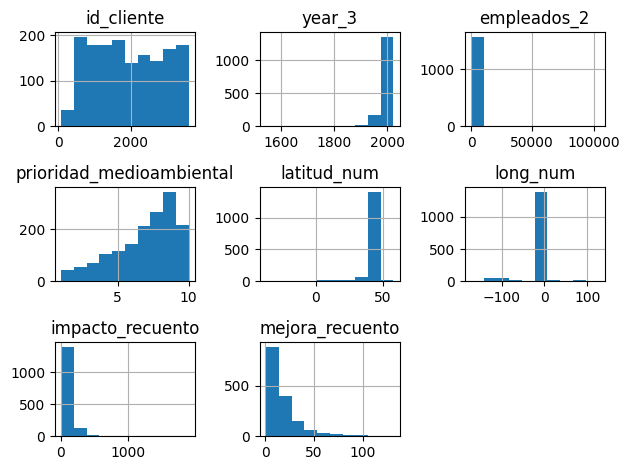

In [39]:
# Variables numericas
import matplotlib.pyplot as plt

df_limpio.hist()
plt.tight_layout()

In [40]:
df_limpio.describe()

,id_cliente,year_3,empleados_2,prioridad_medioambiental,latitud_num,long_num,impacto_recuento,mejora_recuento
count,1571.000000,1571.000000,1571.000000,1571.000000,1571.000000,1571.000000,1571.000000,1571.000000
mean,1919.639720,1996.014640,331.605347,7.066200,39.856824,-7.401234,115.823679,17.161680
std,974.104737,29.486159,3954.875625,2.411638,8.418656,30.608373,103.309263,17.485297
min,86.000000,1542.000000,0.000000,1.000000,-36.798193,-171.233000,6.000000,1.000000
25%,1073.500000,1989.000000,3.000000,6.000000,41.553716,-1.030716,63.000000,6.000000
50%,1838.000000,2002.000000,12.000000,8.000000,41.656100,-0.877300,88.000000,11.000000
75%,2808.500000,2013.000000,44.000000,9.000000,41.681279,-0.789840,136.000000,22.000000
max,3582.000000,2024.000000,104000.000000,10.000000,57.824236,126.228650,1896.000000,131.000000


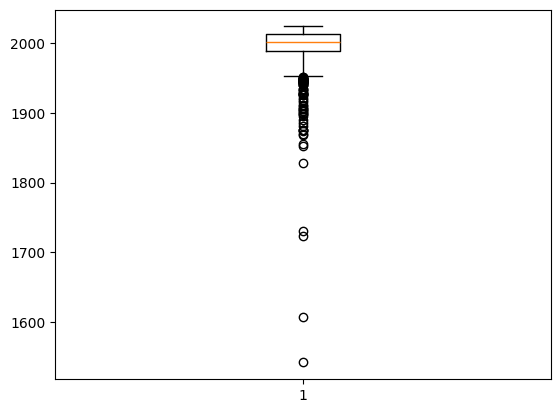

In [84]:
# Boxplot
plt.boxplot(df_limpio['year_3']);

In [ ]:
# Aplicar escalado, mantenemos outliers

Text(0.5, 1.0, 'Variable categórica')

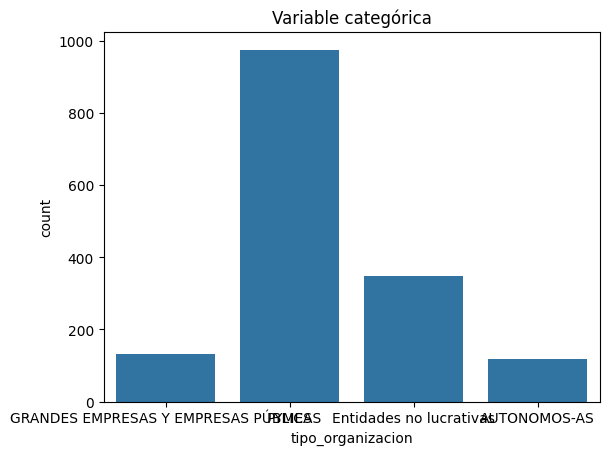

In [76]:
import seaborn as sns

sns.countplot(data=df_limpio, x="tipo_organizacion")
plt.title("Variable categórica")

Text(0.5, 1.0, 'Variable categórica')

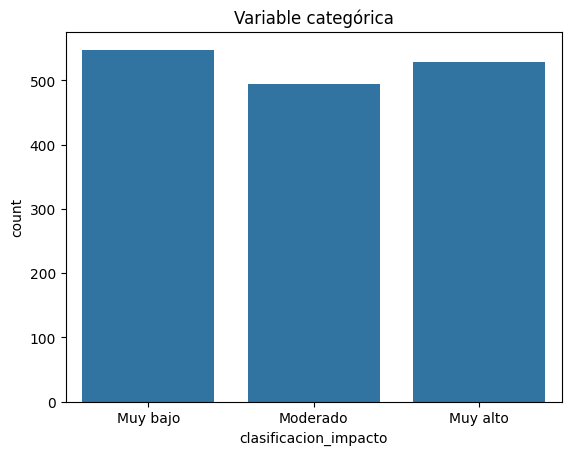

In [78]:
sns.countplot(data=df_limpio, x="clasificacion_impacto")
plt.title("Variable categórica")

In [86]:
train_set = df_limpio.drop("id_cliente", axis = 1)

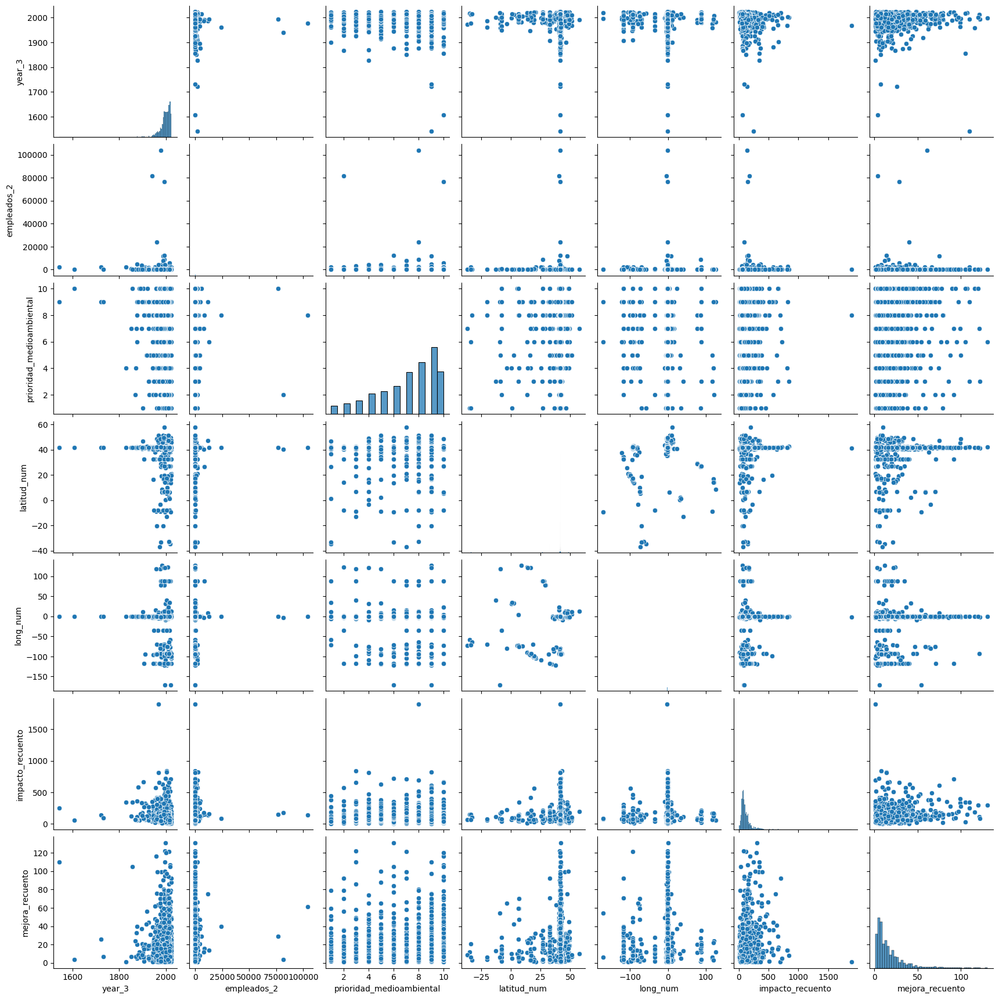

In [87]:
sns.pairplot(train_set)

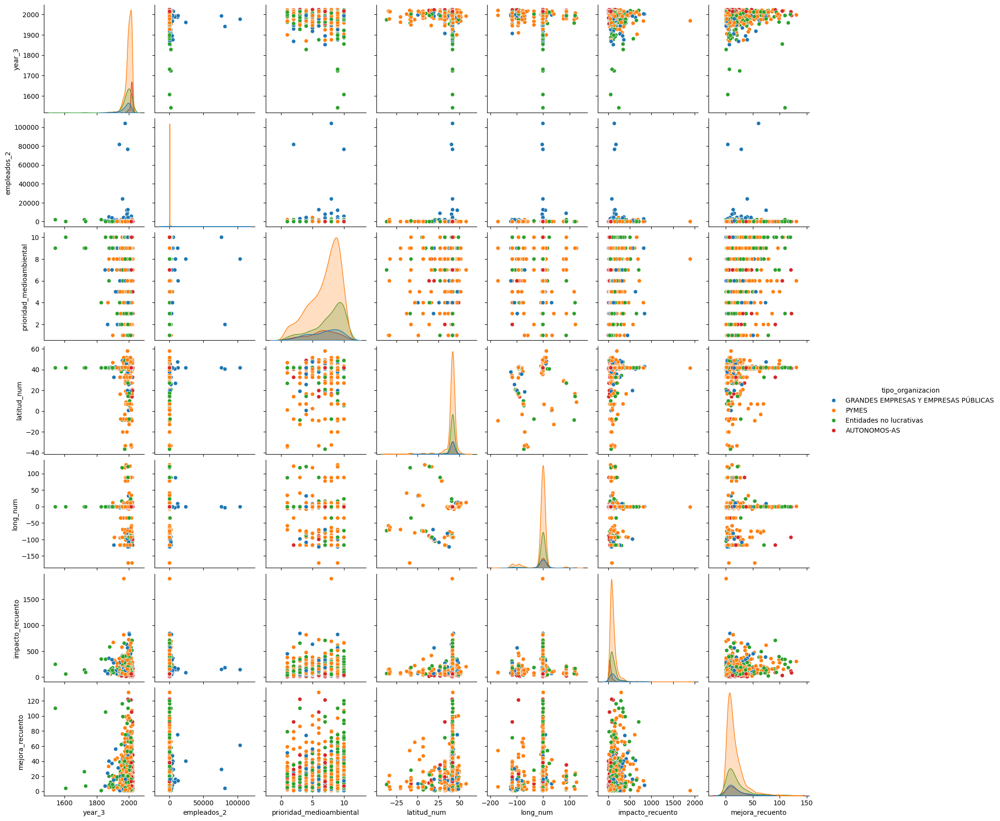

In [88]:
sns.pairplot(train_set, hue="tipo_organizacion")

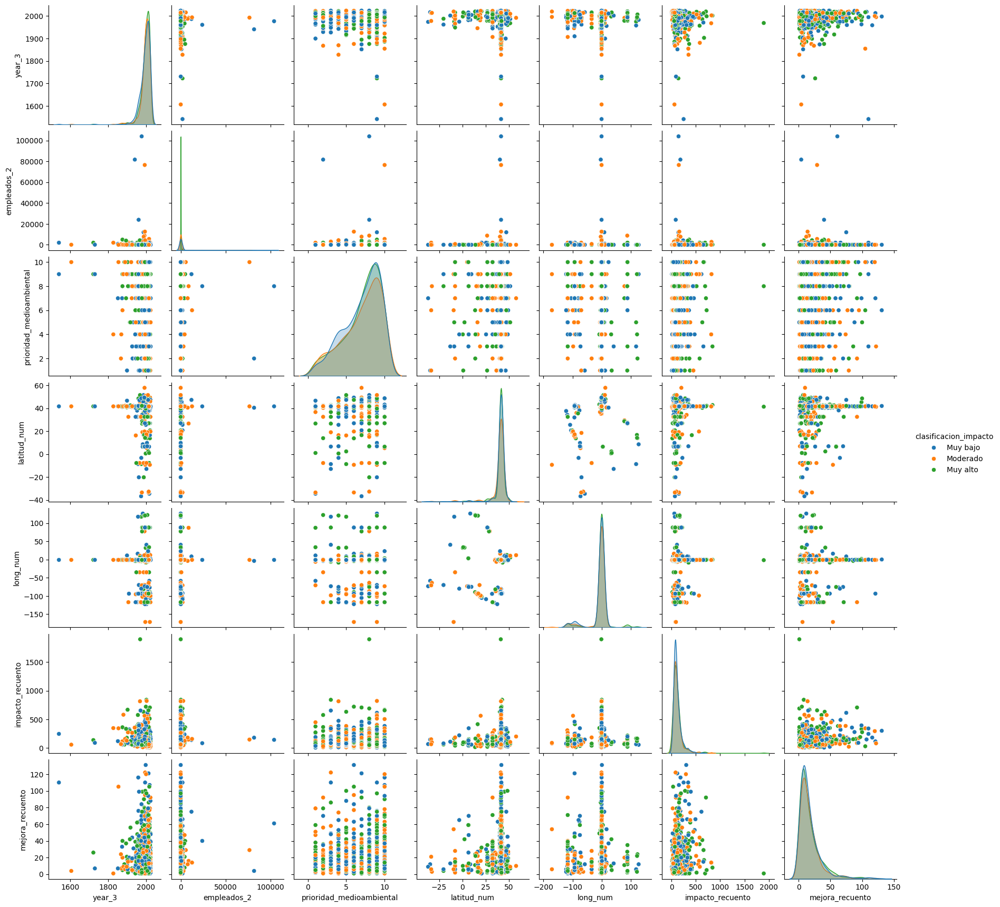

In [89]:
sns.pairplot(train_set, hue="clasificacion_impacto");

In [46]:
### Implementando un Clustering Jerárquico Aglomerativo

In [ ]:
from sklearn.cluster import AgglomerativeClustering

clustering_model = AgglomerativeClustering(n_clusters=5, metric='euclidean', 
                                           linkage='ward')
clustering_model.fit(selected_data)
clustering_model.labels_